# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

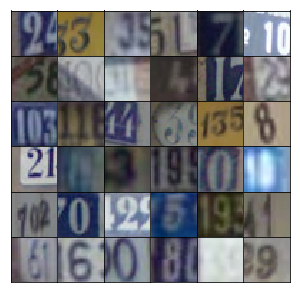

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def batch_norm_transpose_conv(input_x, filters, training, kernel=3):
    
    batch = input_x.get_shape().as_list()[0]
    in_channels = input_x.get_shape().as_list()[3]
    out_channels = filters if filters else int(in_channels / 2)
    out_shape = np.array([batch, kernel, kernel, out_channels])
    
    weights = tf.Variable(tf.truncated_normal([kernel, kernel, out_channels, in_channels], stddev=0.05))
        
    gamma = tf.Variable(tf.ones(out_channels))
    beta = tf.Variable(tf.zeros(out_channels))
    
    pop_mean = tf.Variable(tf.zeros([out_channels]), trainable=False)
    pop_variance = tf.Variable(tf.zeros([out_channels]), trainable=False)
    
    epsilon = 1e-3
    
    # conv_transpose = tf.nn.conv2d_transpose(input_x, weights, out_shape, strides=[1,2,2,1], padding='SAME')
    conv_transpose = tf.layers.conv2d_transpose(input_x, filters, kernel_size=kernel, strides=(2, 2), padding='same')
    
    def batch_norm_training():
        decay = 0.99
        
        batch_mean, batch_variance = tf.nn.moments(conv_transpose, [0,1,2], keep_dims=False)
        
        train_mean = tf.assign(pop_mean, batch_mean * decay + pop_mean * (1 - decay))
        train_variance = tf.assign(pop_variance, batch_variance * decay + pop_variance * (1 - decay))
        
        with tf.control_dependencies([train_mean, train_variance]):
            return (conv_transpose - batch_mean) / tf.sqrt(batch_variance + epsilon)
    
    def batch_norm_inference():
        return (conv_transpose - pop_mean) / tf.sqrt(pop_variance + epsilon)
    
#     conv_transpose = tf.cond(training, batch_norm_training, batch_norm_inference)
    
    if training:
        conv_transpose = batch_norm_training()
    else:
        conv_transpose = batch_norm_inference()

    return gamma * conv_transpose + beta       

In [10]:
def lrelu(input_x, alpha):
            return tf.maximum(alpha * input_x, input_x)

In [11]:
def generator2(z, output_dim, training=True, reuse=False, alpha=0.2):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer --> conv 4x4x512
        layer_1 = tf.layers.dense(z, 4*4*512, activation=None, use_bias=False)
        layer_1 = tf.reshape(layer_1, (-1,4,4,512))
        layer_1 = lrelu(layer_1, alpha)
        
        # Second conv layer 4x4x512 --> 8x8x256
        layer_2 = batch_norm_transpose_conv(layer_1, filters=256, training=training)
        layer_2 = lrelu(layer_2, alpha)
        
        # Third conv layer 8x8x256 --> 16x16x128
        layer_3 = batch_norm_transpose_conv(layer_2, filters=128, training=training)
        layer_3 = lrelu(layer_3, alpha)
        
        # Output layer, 32x32x3
        logits = batch_norm_transpose_conv(layer_3, filters=3, training=training)
        
        out = tf.tanh(logits)
        
        return out

In [12]:
def generator(z, output_dim, training=True, reuse=False, alpha=0.2):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer --> conv 4x4x512
        layer_1 = tf.layers.dense(z, 4*4*512)
        layer_1 = tf.reshape(layer_1, (-1,4,4,512))
        layer_1 = tf.layers.batch_normalization(layer_1, training=training)
        layer_1 = tf.maximum(alpha * layer_1, layer_1)
#         layer_1 = lrelu(layer_1, alpha)
        
        # Second conv layer 4x4x512 --> 8x8x256
        layer_2 = tf.layers.conv2d_transpose(layer_1, 256, 5, strides=2, padding='same')
        layer_2 = tf.layers.batch_normalization(layer_2, training=training)
        layer_2 = tf.maximum(alpha * layer_2, layer_2)
#         layer_2 = lrelu(layer_2, alpha)
        
        # Third conv layer 8x8x256 --> 16x16x128
        layer_3 = tf.layers.conv2d_transpose(layer_2, 128, 5, strides=2, padding='same')
        layer_3 = tf.layers.batch_normalization(layer_3, training=training)
        layer_3 = tf.maximum(alpha * layer_3, layer_3)
#         layer_3 = lrelu(layer_3, alpha)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(layer_3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [13]:
def batch_norm_conv(input_x, filters, kernel=3):
    ''' 
    The discriminator will be always training, so there's no need to specify 1
    function for training and 1 for inference
    '''
    
    batch = input_x.get_shape().as_list()[0]
    in_channels = input_x.get_shape().as_list()[3]
    out_channels = filters if filters else in_channels * 2
    out_shape = [batch, kernel, kernel, out_channels]
    strides = [1, 2, 2, 1]
    
    weights = tf.Variable(tf.truncated_normal([kernel, kernel, in_channels, out_channels], stddev=0.05))
    
    conv_layer = tf.nn.conv2d(input_x,weights,strides,padding='SAME')
    
    gamma = tf.Variable(tf.ones([out_channels]))
    beta = tf.Variable(tf.ones([out_channels]))
    
    epsilon = 1e-3
    decay = 0.99
    
    batch_mean, batch_variance = tf.nn.moments(conv_layer, axes=[0,1,2], keep_dims=False)
    
    conv_layer = (conv_layer - batch_mean) / tf.sqrt(batch_variance + epsilon)
    return gamma * conv_layer + beta

In [14]:
def discriminator2(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 --> 16x16x64
        layer_1 = batch_norm_conv(x, filters=64)
        layer_1 = lrelu(layer_1, alpha)
        
        # Layer 2 16x16x64 --> 8x8x128
        layer_2 = batch_norm_conv(layer_1, filters=128)
        layer_2 = lrelu(layer_2, alpha)
        
        # Layer 3 8x8x128 --> 4x4x256
        layer_3 = batch_norm_conv(layer_2, filters=256)
        layer_3 = lrelu(layer_3, alpha)
        
        # Layer 4 4x4x256 --> 2x2x512
        layer_4 = batch_norm_conv(layer_3, filters=512)
        layer_4 = lrelu(layer_4, alpha)        
        
        # Makeing the layer flat fo use in the output
        flat = tf.reshape(layer_4, [-1, 2*2*512])
        
        logits = tf.layers.dense(flat, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

In [15]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 --> 16x16x64
        layer_1 = tf.layers.conv2d(x, 64, 5, strides=(2,2), padding='same')
        layer_1 = lrelu(layer_1, alpha)
        
        # Layer 2 16x16x64 --> 8x8x128
        layer_2 = tf.layers.conv2d(layer_1, 128, 5, strides=(2,2), padding='same')
        layer_2 = tf.layers.batch_normalization(layer_2, training=True)
        layer_2 = lrelu(layer_2, alpha)
        
        # Layer 3 8x8x128 --> 4x4x256
        layer_3 = tf.layers.conv2d(layer_2, 256, 5, strides=(2,2), padding='same')
        layer_3 = tf.layers.batch_normalization(layer_3, training=True)
        layer_3 = lrelu(layer_3, alpha)
        
        # Layer 4 4x4x256 --> 2x2x512
        layer_4 = tf.layers.conv2d(layer_3, 512, 5, strides=(2,2), padding='same')
        layer_4 = tf.layers.batch_normalization(layer_4, training=True)
        layer_4 = lrelu(layer_4, alpha)        
        
        # Makeing the layer flat fo use in the output
        flat = tf.reshape(layer_4, (-1, 2*2*512))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [16]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [17]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [18]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [19]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [20]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 20
alpha = 0.1
beta1 = 0.7

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 0.0253... Generator Loss: 14.4281
Epoch 1/20... Discriminator Loss: 0.0109... Generator Loss: 13.3590
Epoch 1/20... Discriminator Loss: 0.0441... Generator Loss: 12.9751
Epoch 1/20... Discriminator Loss: 0.3213... Generator Loss: 5.4268
Epoch 1/20... Discriminator Loss: 1.3555... Generator Loss: 0.6771
Epoch 1/20... Discriminator Loss: 0.4514... Generator Loss: 1.6228
Epoch 1/20... Discriminator Loss: 0.2677... Generator Loss: 2.3872
Epoch 1/20... Discriminator Loss: 0.1836... Generator Loss: 2.3235
Epoch 1/20... Discriminator Loss: 0.2643... Generator Loss: 2.3748
Epoch 1/20... Discriminator Loss: 0.7021... Generator Loss: 2.0044


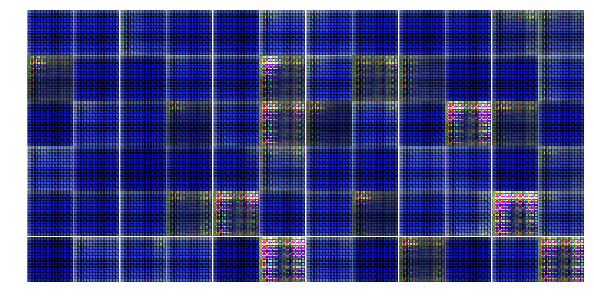

Epoch 1/20... Discriminator Loss: 0.0300... Generator Loss: 4.2268
Epoch 1/20... Discriminator Loss: 0.0301... Generator Loss: 6.2675
Epoch 1/20... Discriminator Loss: 10.4989... Generator Loss: 11.6044
Epoch 1/20... Discriminator Loss: 0.6442... Generator Loss: 1.8085
Epoch 1/20... Discriminator Loss: 1.4530... Generator Loss: 0.5058
Epoch 1/20... Discriminator Loss: 1.1115... Generator Loss: 0.8859
Epoch 1/20... Discriminator Loss: 0.2272... Generator Loss: 2.1138
Epoch 1/20... Discriminator Loss: 0.4470... Generator Loss: 2.6508
Epoch 1/20... Discriminator Loss: 0.7772... Generator Loss: 1.6524
Epoch 1/20... Discriminator Loss: 0.8624... Generator Loss: 0.8111


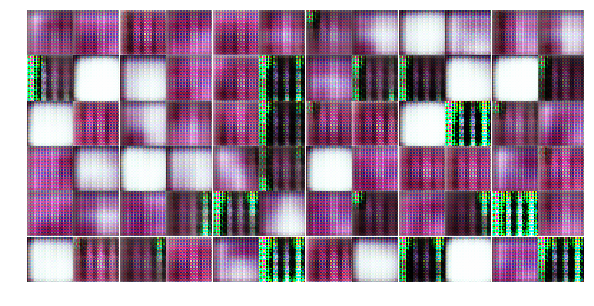

Epoch 1/20... Discriminator Loss: 2.3131... Generator Loss: 0.2364
Epoch 1/20... Discriminator Loss: 0.6095... Generator Loss: 1.8798
Epoch 1/20... Discriminator Loss: 1.0766... Generator Loss: 0.6686
Epoch 1/20... Discriminator Loss: 0.4500... Generator Loss: 1.4651
Epoch 1/20... Discriminator Loss: 0.4440... Generator Loss: 2.0104
Epoch 1/20... Discriminator Loss: 0.7335... Generator Loss: 3.5915
Epoch 1/20... Discriminator Loss: 0.4259... Generator Loss: 2.2827
Epoch 1/20... Discriminator Loss: 5.7203... Generator Loss: 0.0075
Epoch 1/20... Discriminator Loss: 0.3895... Generator Loss: 1.5409
Epoch 1/20... Discriminator Loss: 2.5781... Generator Loss: 3.8371


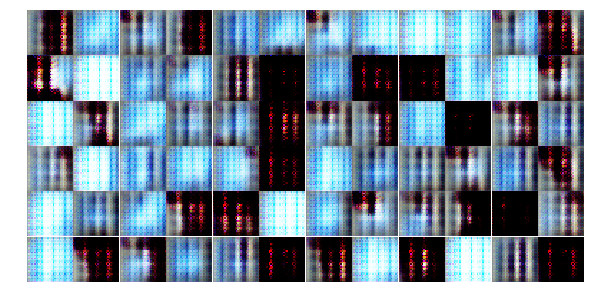

Epoch 1/20... Discriminator Loss: 1.0133... Generator Loss: 0.8029
Epoch 1/20... Discriminator Loss: 0.8302... Generator Loss: 1.0277
Epoch 1/20... Discriminator Loss: 0.4730... Generator Loss: 1.6559
Epoch 1/20... Discriminator Loss: 1.5491... Generator Loss: 0.3963
Epoch 1/20... Discriminator Loss: 0.7883... Generator Loss: 1.4810
Epoch 1/20... Discriminator Loss: 0.5679... Generator Loss: 2.1839
Epoch 1/20... Discriminator Loss: 0.3027... Generator Loss: 2.0993
Epoch 1/20... Discriminator Loss: 0.2469... Generator Loss: 2.4242
Epoch 1/20... Discriminator Loss: 0.2233... Generator Loss: 3.2620
Epoch 1/20... Discriminator Loss: 0.1952... Generator Loss: 2.9407


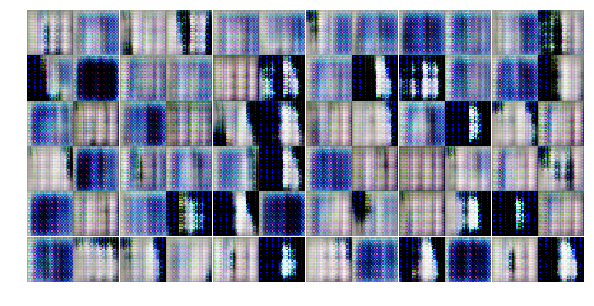

Epoch 1/20... Discriminator Loss: 0.4509... Generator Loss: 1.4608
Epoch 1/20... Discriminator Loss: 0.1172... Generator Loss: 3.0687
Epoch 1/20... Discriminator Loss: 0.2198... Generator Loss: 2.1075
Epoch 1/20... Discriminator Loss: 1.3082... Generator Loss: 0.6407
Epoch 1/20... Discriminator Loss: 1.4418... Generator Loss: 1.8390
Epoch 1/20... Discriminator Loss: 1.1315... Generator Loss: 1.9043
Epoch 1/20... Discriminator Loss: 0.4163... Generator Loss: 1.9369
Epoch 1/20... Discriminator Loss: 2.2675... Generator Loss: 4.5894
Epoch 1/20... Discriminator Loss: 0.7864... Generator Loss: 1.3424
Epoch 1/20... Discriminator Loss: 0.2411... Generator Loss: 2.1403


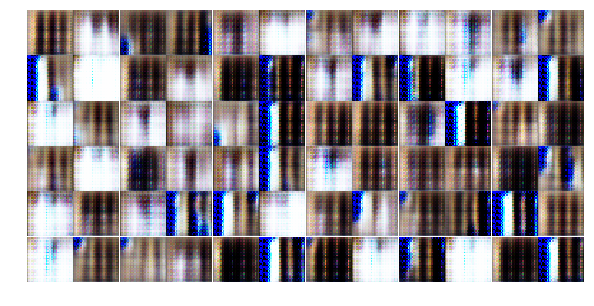

Epoch 1/20... Discriminator Loss: 0.2205... Generator Loss: 2.5153
Epoch 1/20... Discriminator Loss: 0.0553... Generator Loss: 4.0387
Epoch 1/20... Discriminator Loss: 0.9765... Generator Loss: 5.8750
Epoch 1/20... Discriminator Loss: 0.2682... Generator Loss: 2.2870
Epoch 1/20... Discriminator Loss: 0.9204... Generator Loss: 3.6188
Epoch 1/20... Discriminator Loss: 0.2995... Generator Loss: 2.0358
Epoch 1/20... Discriminator Loss: 0.6451... Generator Loss: 1.7330
Epoch 2/20... Discriminator Loss: 0.3329... Generator Loss: 1.7606
Epoch 2/20... Discriminator Loss: 0.2399... Generator Loss: 2.4152
Epoch 2/20... Discriminator Loss: 3.4116... Generator Loss: 0.0461


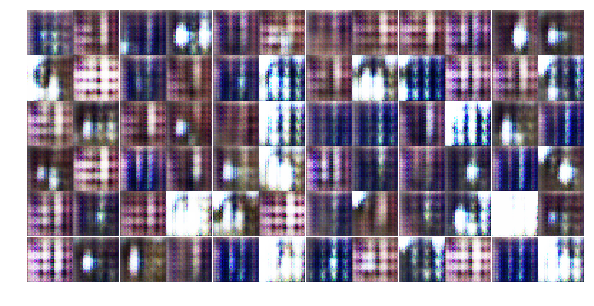

Epoch 2/20... Discriminator Loss: 0.5898... Generator Loss: 2.6754
Epoch 2/20... Discriminator Loss: 0.4985... Generator Loss: 1.6784
Epoch 2/20... Discriminator Loss: 0.1896... Generator Loss: 5.0463
Epoch 2/20... Discriminator Loss: 0.6742... Generator Loss: 5.9707
Epoch 2/20... Discriminator Loss: 1.2980... Generator Loss: 0.5268
Epoch 2/20... Discriminator Loss: 0.1936... Generator Loss: 4.0158
Epoch 2/20... Discriminator Loss: 0.1294... Generator Loss: 2.3956
Epoch 2/20... Discriminator Loss: 0.7158... Generator Loss: 2.9236
Epoch 2/20... Discriminator Loss: 0.1513... Generator Loss: 2.3619
Epoch 2/20... Discriminator Loss: 0.6194... Generator Loss: 3.6784


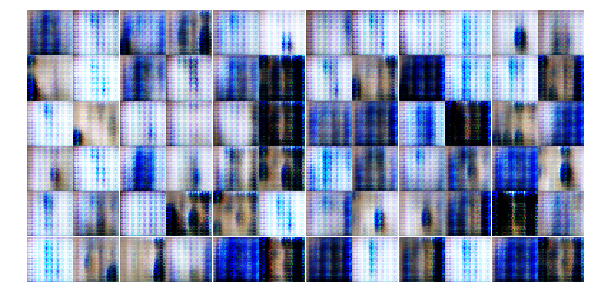

Epoch 2/20... Discriminator Loss: 0.5032... Generator Loss: 1.3063
Epoch 2/20... Discriminator Loss: 0.4684... Generator Loss: 3.8475
Epoch 2/20... Discriminator Loss: 0.4988... Generator Loss: 1.5776
Epoch 2/20... Discriminator Loss: 2.6833... Generator Loss: 3.7957
Epoch 2/20... Discriminator Loss: 0.7403... Generator Loss: 1.6460
Epoch 2/20... Discriminator Loss: 0.4428... Generator Loss: 2.0725
Epoch 2/20... Discriminator Loss: 0.2530... Generator Loss: 3.6562
Epoch 2/20... Discriminator Loss: 0.1806... Generator Loss: 3.1322
Epoch 2/20... Discriminator Loss: 0.4327... Generator Loss: 1.6224
Epoch 2/20... Discriminator Loss: 1.1327... Generator Loss: 2.5438


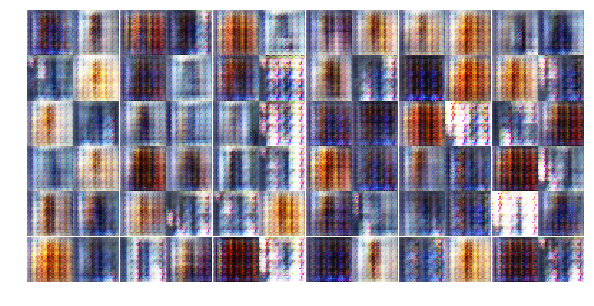

Epoch 2/20... Discriminator Loss: 1.0313... Generator Loss: 1.9304
Epoch 2/20... Discriminator Loss: 0.1509... Generator Loss: 2.1955
Epoch 2/20... Discriminator Loss: 0.9290... Generator Loss: 0.5902
Epoch 2/20... Discriminator Loss: 0.2849... Generator Loss: 1.9281
Epoch 2/20... Discriminator Loss: 0.5425... Generator Loss: 1.2771
Epoch 2/20... Discriminator Loss: 0.4882... Generator Loss: 1.9031
Epoch 2/20... Discriminator Loss: 1.2190... Generator Loss: 0.6108
Epoch 2/20... Discriminator Loss: 0.7804... Generator Loss: 1.5983
Epoch 2/20... Discriminator Loss: 0.5659... Generator Loss: 2.6488
Epoch 2/20... Discriminator Loss: 0.6771... Generator Loss: 1.2831


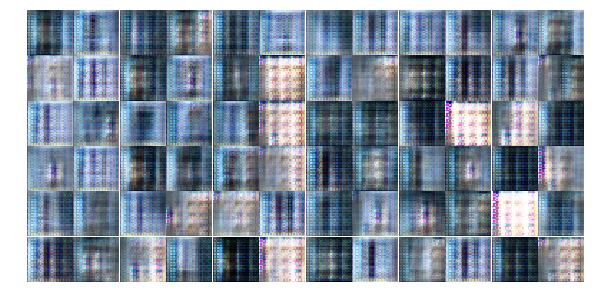

Epoch 2/20... Discriminator Loss: 0.7993... Generator Loss: 2.7724
Epoch 2/20... Discriminator Loss: 0.3297... Generator Loss: 1.7014
Epoch 2/20... Discriminator Loss: 1.7439... Generator Loss: 4.0486
Epoch 2/20... Discriminator Loss: 0.1368... Generator Loss: 2.6767
Epoch 2/20... Discriminator Loss: 0.6941... Generator Loss: 1.4781
Epoch 2/20... Discriminator Loss: 1.3549... Generator Loss: 1.8683
Epoch 2/20... Discriminator Loss: 0.8329... Generator Loss: 0.9720
Epoch 2/20... Discriminator Loss: 0.3273... Generator Loss: 1.7215
Epoch 2/20... Discriminator Loss: 2.2717... Generator Loss: 0.1893
Epoch 2/20... Discriminator Loss: 0.8817... Generator Loss: 1.1499


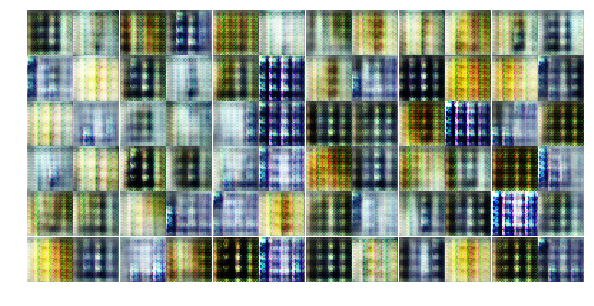

Epoch 2/20... Discriminator Loss: 0.6558... Generator Loss: 1.3122
Epoch 2/20... Discriminator Loss: 0.3467... Generator Loss: 1.7476
Epoch 2/20... Discriminator Loss: 0.8785... Generator Loss: 1.1391
Epoch 2/20... Discriminator Loss: 1.0886... Generator Loss: 0.6957
Epoch 2/20... Discriminator Loss: 1.0535... Generator Loss: 1.5329
Epoch 2/20... Discriminator Loss: 2.0141... Generator Loss: 0.2142
Epoch 2/20... Discriminator Loss: 0.8958... Generator Loss: 1.7512
Epoch 2/20... Discriminator Loss: 0.2982... Generator Loss: 3.2178
Epoch 2/20... Discriminator Loss: 0.0648... Generator Loss: 3.9275
Epoch 2/20... Discriminator Loss: 1.1349... Generator Loss: 4.3320


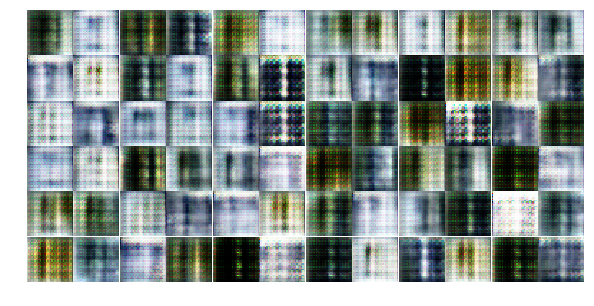

Epoch 2/20... Discriminator Loss: 0.6080... Generator Loss: 2.4924
Epoch 2/20... Discriminator Loss: 0.2239... Generator Loss: 2.4456
Epoch 2/20... Discriminator Loss: 0.2232... Generator Loss: 2.5849
Epoch 2/20... Discriminator Loss: 0.1559... Generator Loss: 4.6937
Epoch 3/20... Discriminator Loss: 0.3055... Generator Loss: 2.2450
Epoch 3/20... Discriminator Loss: 0.5028... Generator Loss: 2.3792
Epoch 3/20... Discriminator Loss: 0.4129... Generator Loss: 1.7248
Epoch 3/20... Discriminator Loss: 0.4402... Generator Loss: 1.4660
Epoch 3/20... Discriminator Loss: 0.4206... Generator Loss: 1.6631
Epoch 3/20... Discriminator Loss: 2.3085... Generator Loss: 0.2627


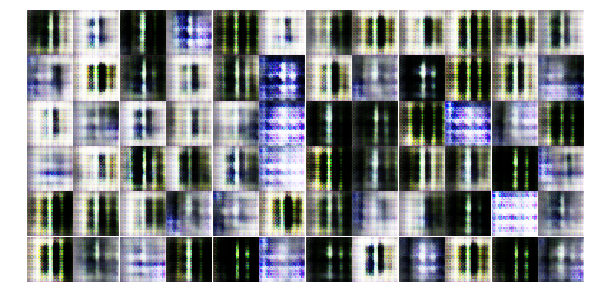

Epoch 3/20... Discriminator Loss: 0.0973... Generator Loss: 4.0118
Epoch 3/20... Discriminator Loss: 0.4457... Generator Loss: 4.4615
Epoch 3/20... Discriminator Loss: 1.9534... Generator Loss: 0.2965
Epoch 3/20... Discriminator Loss: 1.8666... Generator Loss: 0.3161
Epoch 3/20... Discriminator Loss: 0.5672... Generator Loss: 1.6128
Epoch 3/20... Discriminator Loss: 0.9120... Generator Loss: 0.7637
Epoch 3/20... Discriminator Loss: 0.5231... Generator Loss: 3.2235
Epoch 3/20... Discriminator Loss: 0.7497... Generator Loss: 1.0831
Epoch 3/20... Discriminator Loss: 0.2543... Generator Loss: 3.2211
Epoch 3/20... Discriminator Loss: 0.3570... Generator Loss: 2.2607


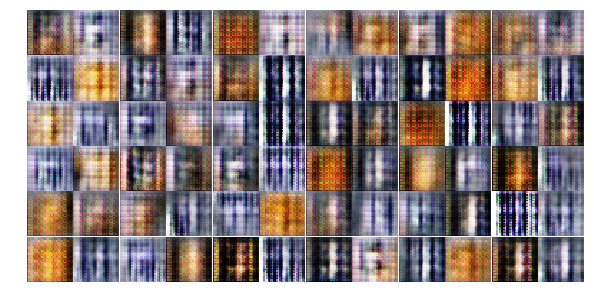

Epoch 3/20... Discriminator Loss: 0.2169... Generator Loss: 2.9996
Epoch 3/20... Discriminator Loss: 0.2380... Generator Loss: 2.5087
Epoch 3/20... Discriminator Loss: 0.1600... Generator Loss: 3.5739
Epoch 3/20... Discriminator Loss: 0.2072... Generator Loss: 3.2069
Epoch 3/20... Discriminator Loss: 1.1537... Generator Loss: 0.6035
Epoch 3/20... Discriminator Loss: 0.8572... Generator Loss: 2.7221
Epoch 3/20... Discriminator Loss: 0.5175... Generator Loss: 1.0838
Epoch 3/20... Discriminator Loss: 0.2055... Generator Loss: 4.3213
Epoch 3/20... Discriminator Loss: 0.4953... Generator Loss: 1.2110
Epoch 3/20... Discriminator Loss: 0.4007... Generator Loss: 1.5375


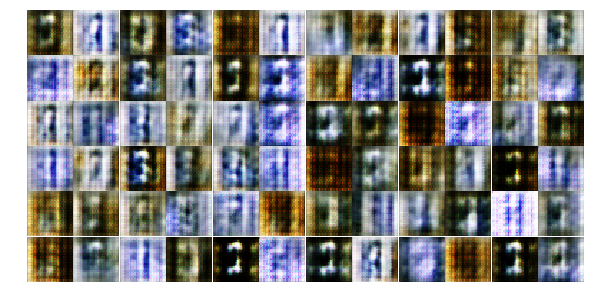

Epoch 3/20... Discriminator Loss: 0.6695... Generator Loss: 4.7236
Epoch 3/20... Discriminator Loss: 1.6080... Generator Loss: 3.4150
Epoch 3/20... Discriminator Loss: 0.4875... Generator Loss: 1.5953
Epoch 3/20... Discriminator Loss: 0.6826... Generator Loss: 2.6717
Epoch 3/20... Discriminator Loss: 0.2271... Generator Loss: 3.3180
Epoch 3/20... Discriminator Loss: 0.6496... Generator Loss: 2.5712
Epoch 3/20... Discriminator Loss: 0.5096... Generator Loss: 1.6633
Epoch 3/20... Discriminator Loss: 0.0439... Generator Loss: 4.4464
Epoch 3/20... Discriminator Loss: 0.6066... Generator Loss: 1.1941
Epoch 3/20... Discriminator Loss: 0.1914... Generator Loss: 2.5529


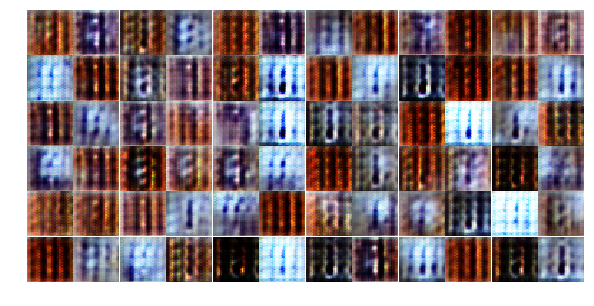

Epoch 3/20... Discriminator Loss: 1.3490... Generator Loss: 5.4705
Epoch 3/20... Discriminator Loss: 0.3270... Generator Loss: 2.7094
Epoch 3/20... Discriminator Loss: 0.4763... Generator Loss: 4.3504
Epoch 3/20... Discriminator Loss: 0.2537... Generator Loss: 2.7914
Epoch 3/20... Discriminator Loss: 1.3992... Generator Loss: 0.4669
Epoch 3/20... Discriminator Loss: 0.3534... Generator Loss: 1.9606
Epoch 3/20... Discriminator Loss: 0.9469... Generator Loss: 5.2844
Epoch 3/20... Discriminator Loss: 1.2503... Generator Loss: 2.0249
Epoch 3/20... Discriminator Loss: 0.3692... Generator Loss: 2.5975
Epoch 3/20... Discriminator Loss: 0.6878... Generator Loss: 0.9298


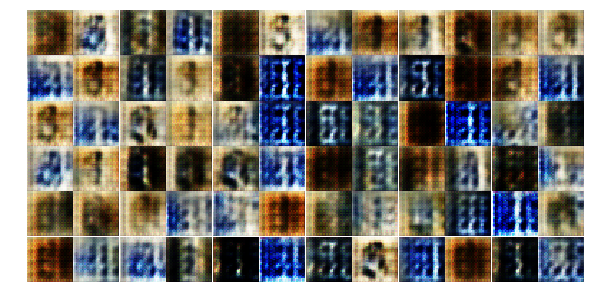

Epoch 3/20... Discriminator Loss: 0.4430... Generator Loss: 2.4212
Epoch 3/20... Discriminator Loss: 0.4103... Generator Loss: 3.4921
Epoch 3/20... Discriminator Loss: 0.4554... Generator Loss: 1.3544
Epoch 3/20... Discriminator Loss: 1.1590... Generator Loss: 0.8706
Epoch 3/20... Discriminator Loss: 0.8069... Generator Loss: 0.9750
Epoch 3/20... Discriminator Loss: 0.1494... Generator Loss: 4.0248
Epoch 3/20... Discriminator Loss: 0.4811... Generator Loss: 2.1881
Epoch 3/20... Discriminator Loss: 0.7430... Generator Loss: 0.9534
Epoch 3/20... Discriminator Loss: 0.5705... Generator Loss: 3.0571
Epoch 3/20... Discriminator Loss: 0.8429... Generator Loss: 0.7612


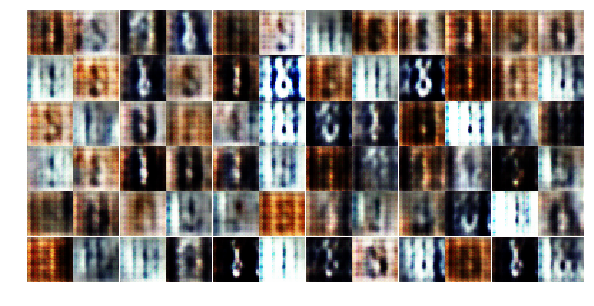

Epoch 3/20... Discriminator Loss: 0.7633... Generator Loss: 2.6900
Epoch 4/20... Discriminator Loss: 0.3494... Generator Loss: 3.2063
Epoch 4/20... Discriminator Loss: 0.2736... Generator Loss: 1.8321
Epoch 4/20... Discriminator Loss: 0.1505... Generator Loss: 3.2159
Epoch 4/20... Discriminator Loss: 2.3510... Generator Loss: 0.1329
Epoch 4/20... Discriminator Loss: 0.2498... Generator Loss: 2.2848
Epoch 4/20... Discriminator Loss: 0.8828... Generator Loss: 0.9842
Epoch 4/20... Discriminator Loss: 0.4582... Generator Loss: 2.7832
Epoch 4/20... Discriminator Loss: 0.5852... Generator Loss: 1.5402
Epoch 4/20... Discriminator Loss: 0.8420... Generator Loss: 1.5554


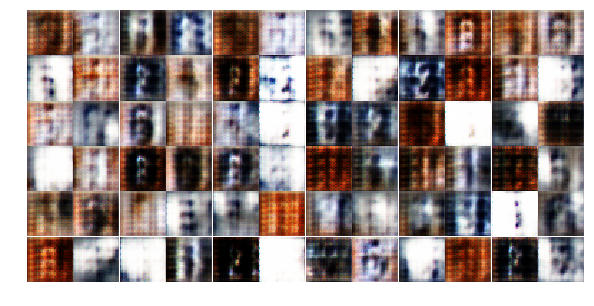

Epoch 4/20... Discriminator Loss: 1.8868... Generator Loss: 0.3287
Epoch 4/20... Discriminator Loss: 0.2640... Generator Loss: 1.8458
Epoch 4/20... Discriminator Loss: 0.7889... Generator Loss: 0.8824
Epoch 4/20... Discriminator Loss: 0.5035... Generator Loss: 1.6328
Epoch 4/20... Discriminator Loss: 0.7624... Generator Loss: 0.8808
Epoch 4/20... Discriminator Loss: 0.4777... Generator Loss: 2.0169
Epoch 4/20... Discriminator Loss: 0.6100... Generator Loss: 1.2280
Epoch 4/20... Discriminator Loss: 0.2480... Generator Loss: 3.2869
Epoch 4/20... Discriminator Loss: 0.6355... Generator Loss: 2.0443
Epoch 4/20... Discriminator Loss: 0.3649... Generator Loss: 1.6017


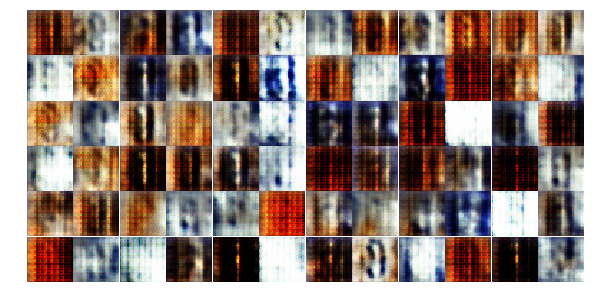

Epoch 4/20... Discriminator Loss: 0.3404... Generator Loss: 4.0964
Epoch 4/20... Discriminator Loss: 0.9215... Generator Loss: 0.6533
Epoch 4/20... Discriminator Loss: 0.9912... Generator Loss: 1.5301
Epoch 4/20... Discriminator Loss: 0.9312... Generator Loss: 0.9319
Epoch 4/20... Discriminator Loss: 0.7539... Generator Loss: 0.9121
Epoch 4/20... Discriminator Loss: 0.4099... Generator Loss: 1.6961
Epoch 4/20... Discriminator Loss: 0.6683... Generator Loss: 1.4455
Epoch 4/20... Discriminator Loss: 0.4242... Generator Loss: 1.6946
Epoch 4/20... Discriminator Loss: 0.5679... Generator Loss: 1.1972
Epoch 4/20... Discriminator Loss: 0.7880... Generator Loss: 1.2086


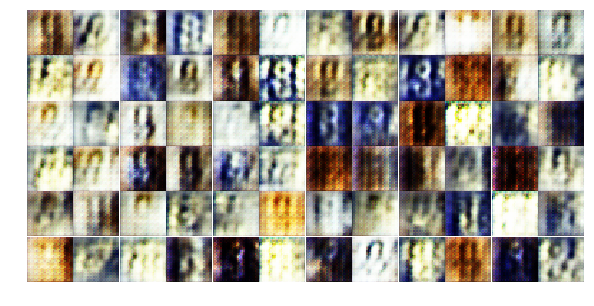

Epoch 4/20... Discriminator Loss: 0.3772... Generator Loss: 1.6194
Epoch 4/20... Discriminator Loss: 1.4018... Generator Loss: 1.4685
Epoch 4/20... Discriminator Loss: 0.2614... Generator Loss: 2.1707
Epoch 4/20... Discriminator Loss: 1.5184... Generator Loss: 3.8765
Epoch 4/20... Discriminator Loss: 0.4633... Generator Loss: 1.1839
Epoch 4/20... Discriminator Loss: 0.4678... Generator Loss: 1.6464
Epoch 4/20... Discriminator Loss: 0.4354... Generator Loss: 1.9261
Epoch 4/20... Discriminator Loss: 0.2321... Generator Loss: 2.6577
Epoch 4/20... Discriminator Loss: 0.4622... Generator Loss: 1.9090
Epoch 4/20... Discriminator Loss: 0.4166... Generator Loss: 4.2848


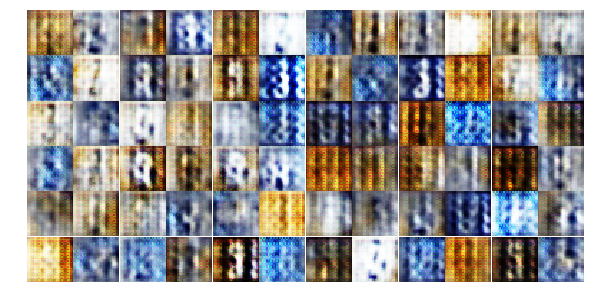

Epoch 4/20... Discriminator Loss: 1.0768... Generator Loss: 0.9865
Epoch 4/20... Discriminator Loss: 0.3230... Generator Loss: 2.8048
Epoch 4/20... Discriminator Loss: 0.5840... Generator Loss: 1.0954
Epoch 4/20... Discriminator Loss: 0.5892... Generator Loss: 1.2537
Epoch 4/20... Discriminator Loss: 0.3004... Generator Loss: 1.7549
Epoch 4/20... Discriminator Loss: 0.3340... Generator Loss: 2.2374
Epoch 4/20... Discriminator Loss: 0.3711... Generator Loss: 2.7130
Epoch 4/20... Discriminator Loss: 0.2775... Generator Loss: 2.4650
Epoch 4/20... Discriminator Loss: 0.4254... Generator Loss: 3.5539
Epoch 4/20... Discriminator Loss: 0.9412... Generator Loss: 0.7583


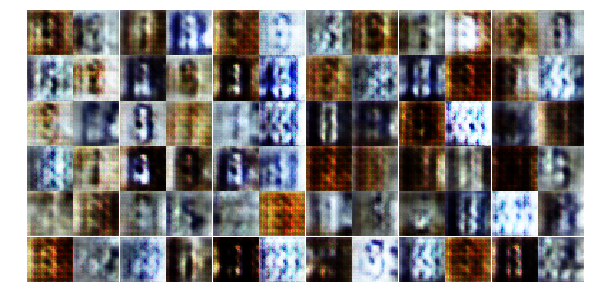

Epoch 4/20... Discriminator Loss: 0.3798... Generator Loss: 2.1111
Epoch 4/20... Discriminator Loss: 0.9943... Generator Loss: 3.0828
Epoch 4/20... Discriminator Loss: 0.9566... Generator Loss: 0.7399
Epoch 4/20... Discriminator Loss: 0.7663... Generator Loss: 1.0047
Epoch 4/20... Discriminator Loss: 0.7394... Generator Loss: 2.1437
Epoch 4/20... Discriminator Loss: 0.6347... Generator Loss: 1.1216
Epoch 4/20... Discriminator Loss: 0.9594... Generator Loss: 0.7271
Epoch 4/20... Discriminator Loss: 0.3027... Generator Loss: 1.7226
Epoch 4/20... Discriminator Loss: 0.3032... Generator Loss: 2.3763
Epoch 5/20... Discriminator Loss: 0.9524... Generator Loss: 0.6875


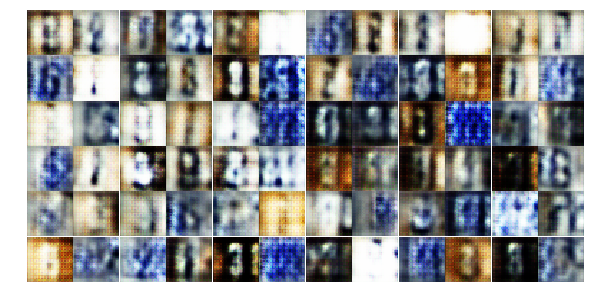

Epoch 5/20... Discriminator Loss: 0.3170... Generator Loss: 3.5054
Epoch 5/20... Discriminator Loss: 0.3264... Generator Loss: 1.8287
Epoch 5/20... Discriminator Loss: 0.9907... Generator Loss: 0.6656
Epoch 5/20... Discriminator Loss: 0.7373... Generator Loss: 1.0758
Epoch 5/20... Discriminator Loss: 0.2850... Generator Loss: 3.7292
Epoch 5/20... Discriminator Loss: 0.5590... Generator Loss: 1.6296
Epoch 5/20... Discriminator Loss: 1.0280... Generator Loss: 0.7569
Epoch 5/20... Discriminator Loss: 0.6271... Generator Loss: 1.0601
Epoch 5/20... Discriminator Loss: 0.6644... Generator Loss: 1.5854
Epoch 5/20... Discriminator Loss: 0.3562... Generator Loss: 1.8178


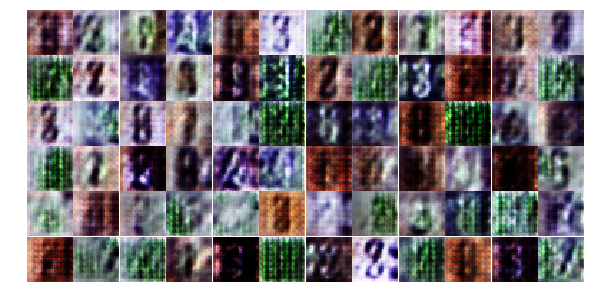

Epoch 5/20... Discriminator Loss: 1.1953... Generator Loss: 2.9303
Epoch 5/20... Discriminator Loss: 1.1357... Generator Loss: 2.6922
Epoch 5/20... Discriminator Loss: 0.2924... Generator Loss: 2.8659
Epoch 5/20... Discriminator Loss: 0.5431... Generator Loss: 1.4434
Epoch 5/20... Discriminator Loss: 0.8752... Generator Loss: 0.9422
Epoch 5/20... Discriminator Loss: 0.3316... Generator Loss: 2.8486
Epoch 5/20... Discriminator Loss: 0.4747... Generator Loss: 2.6516
Epoch 5/20... Discriminator Loss: 1.7663... Generator Loss: 0.3449
Epoch 5/20... Discriminator Loss: 0.2761... Generator Loss: 2.2561
Epoch 5/20... Discriminator Loss: 0.3493... Generator Loss: 2.0900


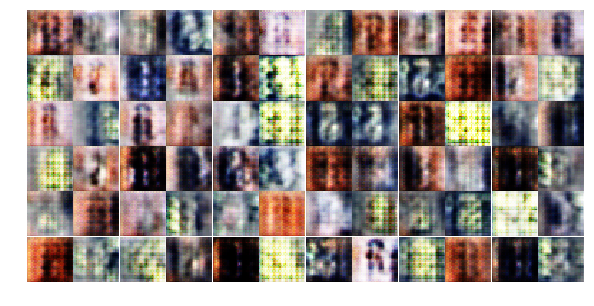

Epoch 5/20... Discriminator Loss: 0.5154... Generator Loss: 1.7874
Epoch 5/20... Discriminator Loss: 0.2795... Generator Loss: 2.2144
Epoch 5/20... Discriminator Loss: 0.6386... Generator Loss: 1.8832
Epoch 5/20... Discriminator Loss: 0.2977... Generator Loss: 2.0133
Epoch 5/20... Discriminator Loss: 0.3407... Generator Loss: 2.1709
Epoch 5/20... Discriminator Loss: 0.4088... Generator Loss: 1.9973
Epoch 5/20... Discriminator Loss: 0.3143... Generator Loss: 3.3033
Epoch 5/20... Discriminator Loss: 0.4250... Generator Loss: 1.7275
Epoch 5/20... Discriminator Loss: 0.8004... Generator Loss: 0.9775
Epoch 5/20... Discriminator Loss: 0.5113... Generator Loss: 1.6637


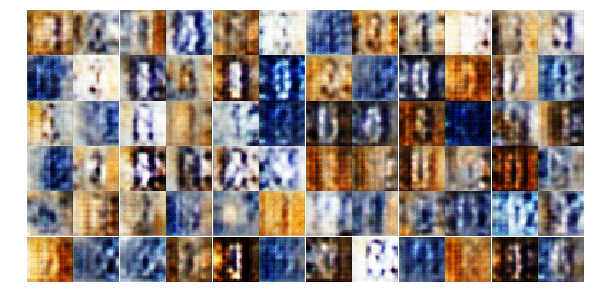

Epoch 5/20... Discriminator Loss: 0.5237... Generator Loss: 1.5501
Epoch 5/20... Discriminator Loss: 0.3785... Generator Loss: 1.4930
Epoch 5/20... Discriminator Loss: 0.3187... Generator Loss: 1.8519
Epoch 5/20... Discriminator Loss: 0.1468... Generator Loss: 2.7044
Epoch 5/20... Discriminator Loss: 0.4512... Generator Loss: 1.8618
Epoch 5/20... Discriminator Loss: 0.4246... Generator Loss: 1.4427
Epoch 5/20... Discriminator Loss: 0.2509... Generator Loss: 2.6216
Epoch 5/20... Discriminator Loss: 0.3424... Generator Loss: 1.7363
Epoch 5/20... Discriminator Loss: 0.2643... Generator Loss: 1.8996
Epoch 5/20... Discriminator Loss: 1.1727... Generator Loss: 0.6350


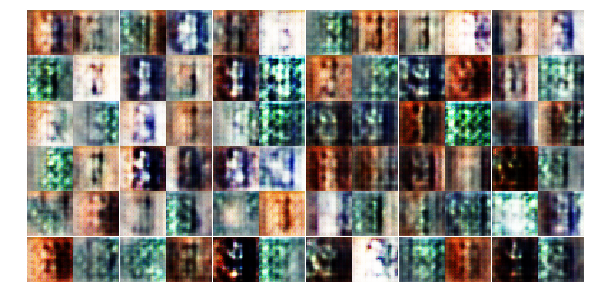

Epoch 5/20... Discriminator Loss: 1.4362... Generator Loss: 6.9976
Epoch 5/20... Discriminator Loss: 0.4284... Generator Loss: 2.1740
Epoch 5/20... Discriminator Loss: 0.1798... Generator Loss: 2.8082
Epoch 5/20... Discriminator Loss: 0.6276... Generator Loss: 1.1207
Epoch 5/20... Discriminator Loss: 0.5631... Generator Loss: 3.2900
Epoch 5/20... Discriminator Loss: 0.9057... Generator Loss: 0.7770
Epoch 5/20... Discriminator Loss: 0.5138... Generator Loss: 1.1979
Epoch 5/20... Discriminator Loss: 0.4074... Generator Loss: 1.7459
Epoch 5/20... Discriminator Loss: 0.3956... Generator Loss: 1.9729
Epoch 5/20... Discriminator Loss: 0.3062... Generator Loss: 1.7925


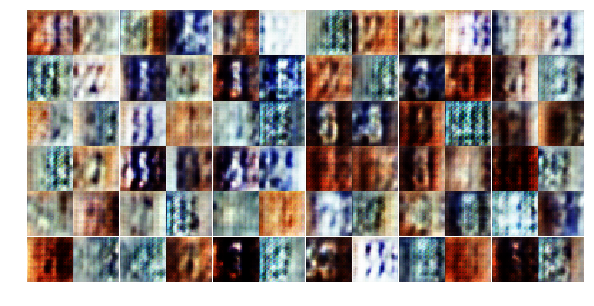

Epoch 5/20... Discriminator Loss: 0.5255... Generator Loss: 2.2162
Epoch 5/20... Discriminator Loss: 0.2333... Generator Loss: 2.7972
Epoch 5/20... Discriminator Loss: 1.4596... Generator Loss: 0.3719
Epoch 5/20... Discriminator Loss: 1.1152... Generator Loss: 0.7498
Epoch 5/20... Discriminator Loss: 0.3235... Generator Loss: 3.0277
Epoch 5/20... Discriminator Loss: 0.2104... Generator Loss: 2.5208
Epoch 6/20... Discriminator Loss: 0.6649... Generator Loss: 1.0705
Epoch 6/20... Discriminator Loss: 0.3042... Generator Loss: 2.8832
Epoch 6/20... Discriminator Loss: 0.3227... Generator Loss: 2.6273
Epoch 6/20... Discriminator Loss: 0.3009... Generator Loss: 2.1232


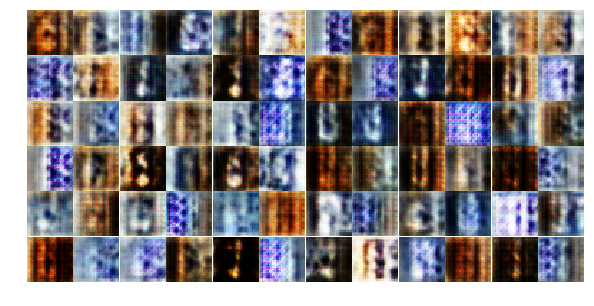

Epoch 6/20... Discriminator Loss: 0.3800... Generator Loss: 3.4511
Epoch 6/20... Discriminator Loss: 0.4416... Generator Loss: 3.5503
Epoch 6/20... Discriminator Loss: 0.3090... Generator Loss: 2.5689
Epoch 6/20... Discriminator Loss: 0.2065... Generator Loss: 3.5828
Epoch 6/20... Discriminator Loss: 0.4185... Generator Loss: 2.1323
Epoch 6/20... Discriminator Loss: 0.8976... Generator Loss: 0.7309
Epoch 6/20... Discriminator Loss: 0.4878... Generator Loss: 2.0600
Epoch 6/20... Discriminator Loss: 0.7009... Generator Loss: 0.9608
Epoch 6/20... Discriminator Loss: 0.3498... Generator Loss: 1.9074
Epoch 6/20... Discriminator Loss: 0.1382... Generator Loss: 2.8635


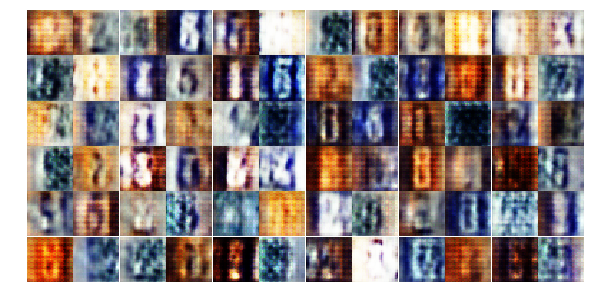

Epoch 6/20... Discriminator Loss: 0.4303... Generator Loss: 1.4931
Epoch 6/20... Discriminator Loss: 0.4166... Generator Loss: 1.4304
Epoch 6/20... Discriminator Loss: 2.1419... Generator Loss: 0.1913
Epoch 6/20... Discriminator Loss: 0.4635... Generator Loss: 1.3255
Epoch 6/20... Discriminator Loss: 0.2877... Generator Loss: 2.5280
Epoch 6/20... Discriminator Loss: 1.2464... Generator Loss: 0.5027
Epoch 6/20... Discriminator Loss: 0.5698... Generator Loss: 1.2896
Epoch 6/20... Discriminator Loss: 0.4165... Generator Loss: 2.4788
Epoch 6/20... Discriminator Loss: 0.1818... Generator Loss: 4.0910
Epoch 6/20... Discriminator Loss: 0.5265... Generator Loss: 1.1948


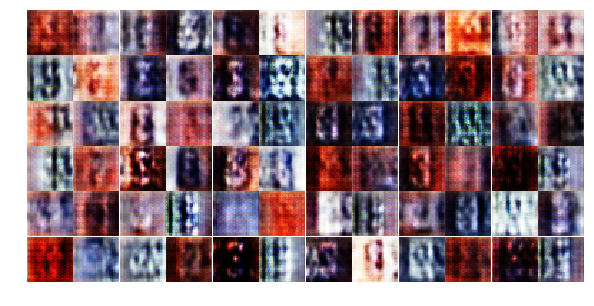

Epoch 6/20... Discriminator Loss: 0.5813... Generator Loss: 1.6725
Epoch 6/20... Discriminator Loss: 0.8915... Generator Loss: 0.7046
Epoch 6/20... Discriminator Loss: 0.5567... Generator Loss: 1.4415
Epoch 6/20... Discriminator Loss: 0.3531... Generator Loss: 1.6667
Epoch 6/20... Discriminator Loss: 0.7829... Generator Loss: 0.8742
Epoch 6/20... Discriminator Loss: 0.1747... Generator Loss: 2.5574
Epoch 6/20... Discriminator Loss: 0.4532... Generator Loss: 1.2668
Epoch 6/20... Discriminator Loss: 0.3723... Generator Loss: 1.5725
Epoch 6/20... Discriminator Loss: 0.3660... Generator Loss: 4.0213
Epoch 6/20... Discriminator Loss: 0.2124... Generator Loss: 2.1222


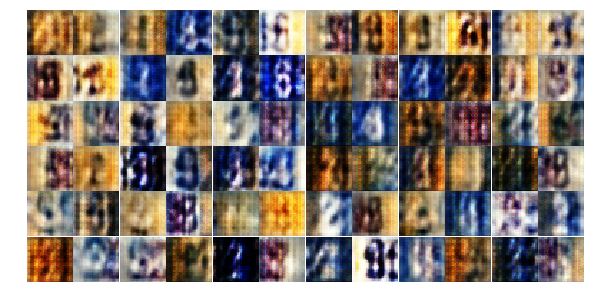

Epoch 6/20... Discriminator Loss: 0.2650... Generator Loss: 3.3876
Epoch 6/20... Discriminator Loss: 0.2968... Generator Loss: 1.7864
Epoch 6/20... Discriminator Loss: 0.1948... Generator Loss: 3.8749
Epoch 6/20... Discriminator Loss: 0.2353... Generator Loss: 2.6128
Epoch 6/20... Discriminator Loss: 0.7729... Generator Loss: 7.6745
Epoch 6/20... Discriminator Loss: 1.0403... Generator Loss: 2.9288
Epoch 6/20... Discriminator Loss: 0.5090... Generator Loss: 1.6457
Epoch 6/20... Discriminator Loss: 0.1795... Generator Loss: 2.6320
Epoch 6/20... Discriminator Loss: 0.6859... Generator Loss: 3.5100
Epoch 6/20... Discriminator Loss: 1.0739... Generator Loss: 0.5851


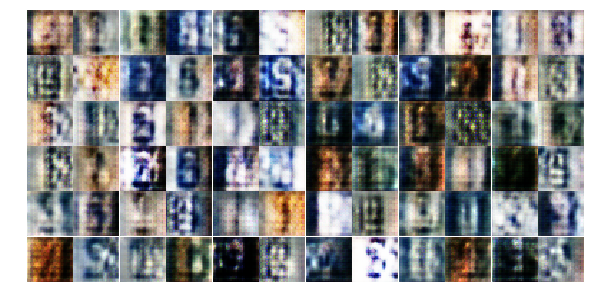

Epoch 6/20... Discriminator Loss: 0.2488... Generator Loss: 2.0860
Epoch 6/20... Discriminator Loss: 0.3012... Generator Loss: 1.8968
Epoch 6/20... Discriminator Loss: 0.3182... Generator Loss: 2.5496
Epoch 6/20... Discriminator Loss: 1.0558... Generator Loss: 0.6428
Epoch 6/20... Discriminator Loss: 0.2628... Generator Loss: 5.3015
Epoch 6/20... Discriminator Loss: 1.2939... Generator Loss: 0.5494
Epoch 6/20... Discriminator Loss: 0.6229... Generator Loss: 4.6175
Epoch 6/20... Discriminator Loss: 2.0141... Generator Loss: 0.2669
Epoch 6/20... Discriminator Loss: 0.1704... Generator Loss: 2.8657
Epoch 6/20... Discriminator Loss: 0.2936... Generator Loss: 2.0686


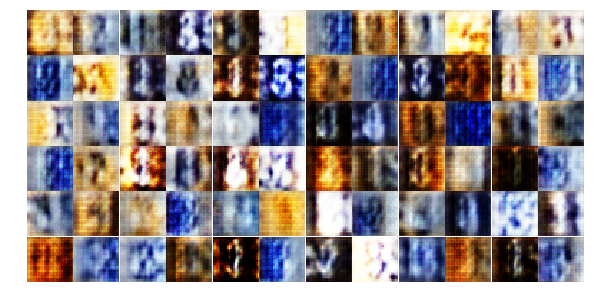

Epoch 6/20... Discriminator Loss: 0.8531... Generator Loss: 0.7466
Epoch 6/20... Discriminator Loss: 0.1672... Generator Loss: 2.5196
Epoch 6/20... Discriminator Loss: 0.3437... Generator Loss: 1.9054
Epoch 7/20... Discriminator Loss: 0.7312... Generator Loss: 1.0160
Epoch 7/20... Discriminator Loss: 0.3244... Generator Loss: 1.6930
Epoch 7/20... Discriminator Loss: 0.1490... Generator Loss: 4.6853
Epoch 7/20... Discriminator Loss: 0.4591... Generator Loss: 1.4199
Epoch 7/20... Discriminator Loss: 0.1656... Generator Loss: 3.1478
Epoch 7/20... Discriminator Loss: 0.7965... Generator Loss: 0.7616
Epoch 7/20... Discriminator Loss: 0.2373... Generator Loss: 4.8870


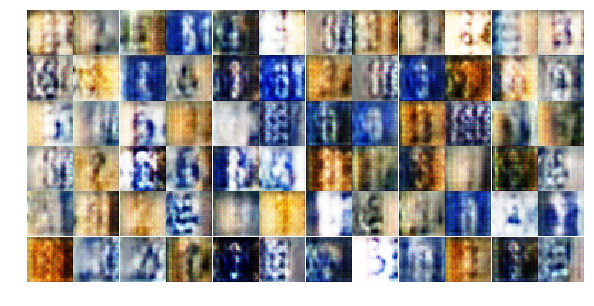

Epoch 7/20... Discriminator Loss: 1.4334... Generator Loss: 0.4581
Epoch 7/20... Discriminator Loss: 0.2419... Generator Loss: 2.6731
Epoch 7/20... Discriminator Loss: 0.3040... Generator Loss: 1.9190
Epoch 7/20... Discriminator Loss: 0.7813... Generator Loss: 0.8476
Epoch 7/20... Discriminator Loss: 0.2863... Generator Loss: 1.8771
Epoch 7/20... Discriminator Loss: 0.5341... Generator Loss: 1.1938
Epoch 7/20... Discriminator Loss: 0.0916... Generator Loss: 3.2380
Epoch 7/20... Discriminator Loss: 0.0906... Generator Loss: 3.4195
Epoch 7/20... Discriminator Loss: 0.2796... Generator Loss: 2.0104
Epoch 7/20... Discriminator Loss: 1.4798... Generator Loss: 0.4026


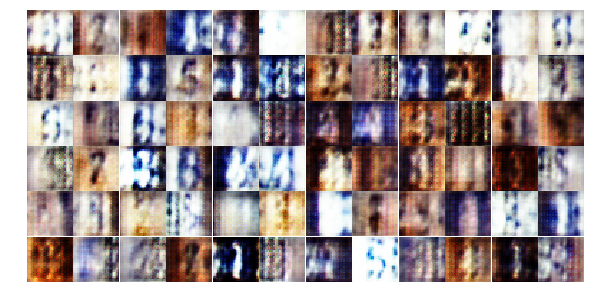

Epoch 7/20... Discriminator Loss: 0.2416... Generator Loss: 2.4885
Epoch 7/20... Discriminator Loss: 0.2005... Generator Loss: 4.3161
Epoch 7/20... Discriminator Loss: 0.3833... Generator Loss: 5.3776
Epoch 7/20... Discriminator Loss: 0.1812... Generator Loss: 3.1873
Epoch 7/20... Discriminator Loss: 0.4429... Generator Loss: 2.6419
Epoch 7/20... Discriminator Loss: 0.1556... Generator Loss: 2.5399
Epoch 7/20... Discriminator Loss: 0.1122... Generator Loss: 2.9007
Epoch 7/20... Discriminator Loss: 0.5165... Generator Loss: 1.1982
Epoch 7/20... Discriminator Loss: 0.1017... Generator Loss: 3.1823
Epoch 7/20... Discriminator Loss: 0.3223... Generator Loss: 1.8455


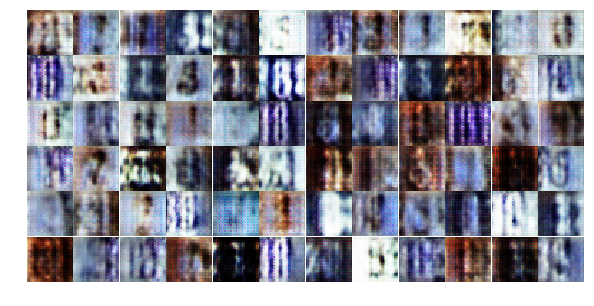

Epoch 7/20... Discriminator Loss: 0.6009... Generator Loss: 4.5025
Epoch 7/20... Discriminator Loss: 0.1910... Generator Loss: 4.4141
Epoch 7/20... Discriminator Loss: 0.8585... Generator Loss: 3.7243
Epoch 7/20... Discriminator Loss: 0.1893... Generator Loss: 2.9293
Epoch 7/20... Discriminator Loss: 0.2429... Generator Loss: 2.4247
Epoch 7/20... Discriminator Loss: 0.0787... Generator Loss: 5.6549
Epoch 7/20... Discriminator Loss: 0.1163... Generator Loss: 3.3073
Epoch 7/20... Discriminator Loss: 0.2557... Generator Loss: 2.3060
Epoch 7/20... Discriminator Loss: 0.7479... Generator Loss: 0.8592
Epoch 7/20... Discriminator Loss: 0.5537... Generator Loss: 1.1666


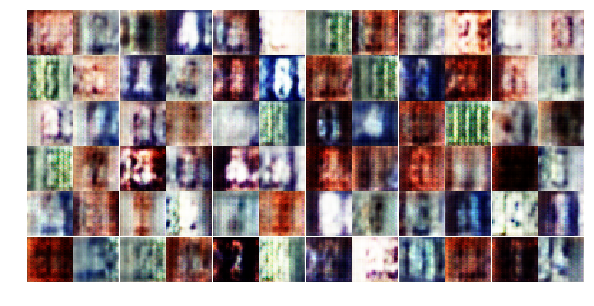

Epoch 7/20... Discriminator Loss: 0.0441... Generator Loss: 4.2445
Epoch 7/20... Discriminator Loss: 2.3452... Generator Loss: 0.2269
Epoch 7/20... Discriminator Loss: 0.3831... Generator Loss: 1.6978
Epoch 7/20... Discriminator Loss: 0.0801... Generator Loss: 4.5684
Epoch 7/20... Discriminator Loss: 0.2618... Generator Loss: 6.4619
Epoch 7/20... Discriminator Loss: 0.1008... Generator Loss: 3.6249
Epoch 7/20... Discriminator Loss: 0.4051... Generator Loss: 1.6900
Epoch 7/20... Discriminator Loss: 0.5290... Generator Loss: 1.2537
Epoch 7/20... Discriminator Loss: 0.2561... Generator Loss: 2.5982
Epoch 7/20... Discriminator Loss: 0.1648... Generator Loss: 2.9121


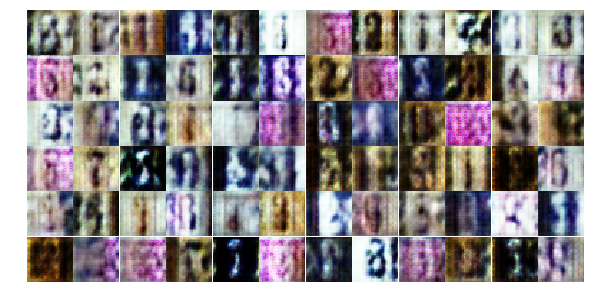

Epoch 7/20... Discriminator Loss: 1.5563... Generator Loss: 0.3780
Epoch 7/20... Discriminator Loss: 0.0934... Generator Loss: 4.4265
Epoch 7/20... Discriminator Loss: 0.0233... Generator Loss: 4.8154
Epoch 7/20... Discriminator Loss: 0.3790... Generator Loss: 3.7543
Epoch 7/20... Discriminator Loss: 0.9697... Generator Loss: 0.6718
Epoch 7/20... Discriminator Loss: 0.0786... Generator Loss: 3.2790
Epoch 7/20... Discriminator Loss: 0.5963... Generator Loss: 1.0594
Epoch 7/20... Discriminator Loss: 0.3908... Generator Loss: 1.5435
Epoch 7/20... Discriminator Loss: 0.2352... Generator Loss: 3.0069
Epoch 7/20... Discriminator Loss: 0.5059... Generator Loss: 1.6474


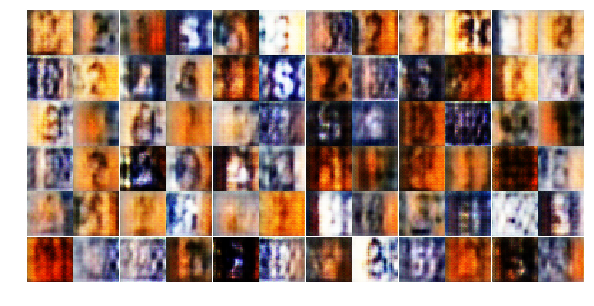

Epoch 7/20... Discriminator Loss: 0.1100... Generator Loss: 3.2890
Epoch 8/20... Discriminator Loss: 0.0345... Generator Loss: 6.4620
Epoch 8/20... Discriminator Loss: 0.2932... Generator Loss: 4.3000
Epoch 8/20... Discriminator Loss: 0.5037... Generator Loss: 5.8494
Epoch 8/20... Discriminator Loss: 0.3866... Generator Loss: 1.9946
Epoch 8/20... Discriminator Loss: 0.1998... Generator Loss: 5.2387
Epoch 8/20... Discriminator Loss: 0.0686... Generator Loss: 3.8346
Epoch 8/20... Discriminator Loss: 1.8471... Generator Loss: 0.2524
Epoch 8/20... Discriminator Loss: 0.9648... Generator Loss: 0.7624
Epoch 8/20... Discriminator Loss: 0.4213... Generator Loss: 1.5325


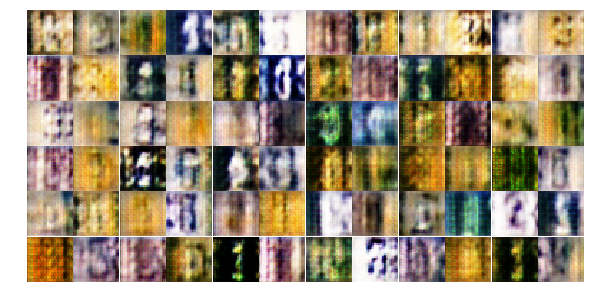

Epoch 8/20... Discriminator Loss: 0.2545... Generator Loss: 2.3032
Epoch 8/20... Discriminator Loss: 0.3894... Generator Loss: 1.4416
Epoch 8/20... Discriminator Loss: 0.4824... Generator Loss: 1.4506
Epoch 8/20... Discriminator Loss: 0.7311... Generator Loss: 0.8447
Epoch 8/20... Discriminator Loss: 1.0516... Generator Loss: 0.6177
Epoch 8/20... Discriminator Loss: 0.4063... Generator Loss: 1.5663
Epoch 8/20... Discriminator Loss: 0.4064... Generator Loss: 1.7162
Epoch 8/20... Discriminator Loss: 0.8340... Generator Loss: 1.0802
Epoch 8/20... Discriminator Loss: 0.3048... Generator Loss: 2.1943
Epoch 8/20... Discriminator Loss: 2.3811... Generator Loss: 0.1511


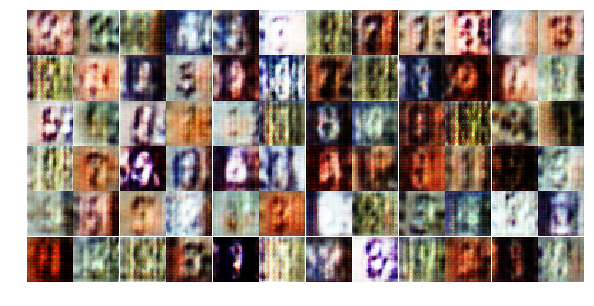

Epoch 8/20... Discriminator Loss: 0.1904... Generator Loss: 2.3441
Epoch 8/20... Discriminator Loss: 0.1421... Generator Loss: 3.4836
Epoch 8/20... Discriminator Loss: 0.3631... Generator Loss: 4.2412
Epoch 8/20... Discriminator Loss: 0.4220... Generator Loss: 3.1889
Epoch 8/20... Discriminator Loss: 0.2221... Generator Loss: 5.4881
Epoch 8/20... Discriminator Loss: 0.3961... Generator Loss: 1.4916
Epoch 8/20... Discriminator Loss: 0.0954... Generator Loss: 2.8728
Epoch 8/20... Discriminator Loss: 0.1445... Generator Loss: 5.7255
Epoch 8/20... Discriminator Loss: 0.5477... Generator Loss: 1.1195
Epoch 8/20... Discriminator Loss: 0.0470... Generator Loss: 3.6440


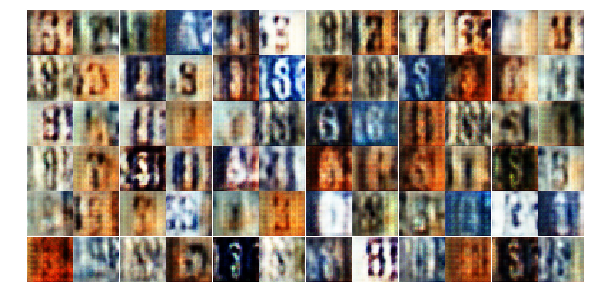

Epoch 8/20... Discriminator Loss: 1.0122... Generator Loss: 0.7123
Epoch 8/20... Discriminator Loss: 1.0711... Generator Loss: 0.7208
Epoch 8/20... Discriminator Loss: 0.1746... Generator Loss: 2.6556
Epoch 8/20... Discriminator Loss: 0.5091... Generator Loss: 1.2151
Epoch 8/20... Discriminator Loss: 0.5666... Generator Loss: 4.1737
Epoch 8/20... Discriminator Loss: 0.0480... Generator Loss: 4.3085
Epoch 8/20... Discriminator Loss: 0.1040... Generator Loss: 5.6714
Epoch 8/20... Discriminator Loss: 0.2225... Generator Loss: 2.6692
Epoch 8/20... Discriminator Loss: 0.7206... Generator Loss: 0.9667
Epoch 8/20... Discriminator Loss: 0.9100... Generator Loss: 0.7526


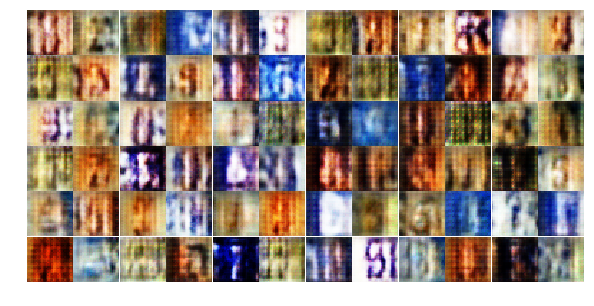

Epoch 8/20... Discriminator Loss: 0.2699... Generator Loss: 2.4036
Epoch 8/20... Discriminator Loss: 0.2262... Generator Loss: 2.0953
Epoch 8/20... Discriminator Loss: 0.3313... Generator Loss: 3.3595
Epoch 8/20... Discriminator Loss: 0.9138... Generator Loss: 0.8376
Epoch 8/20... Discriminator Loss: 0.0439... Generator Loss: 5.1724
Epoch 8/20... Discriminator Loss: 0.4959... Generator Loss: 1.2617
Epoch 8/20... Discriminator Loss: 0.3921... Generator Loss: 5.2058
Epoch 8/20... Discriminator Loss: 0.2561... Generator Loss: 3.6041
Epoch 8/20... Discriminator Loss: 0.1440... Generator Loss: 3.9908
Epoch 8/20... Discriminator Loss: 0.0874... Generator Loss: 3.2755


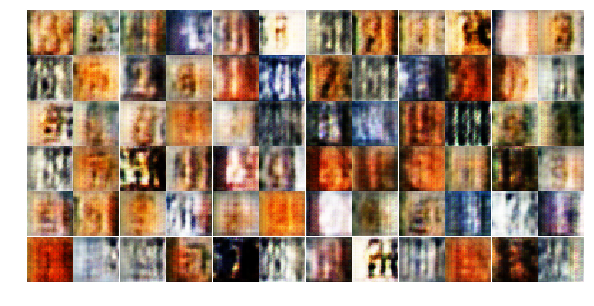

Epoch 8/20... Discriminator Loss: 0.1787... Generator Loss: 3.7063
Epoch 8/20... Discriminator Loss: 0.4845... Generator Loss: 1.3795
Epoch 8/20... Discriminator Loss: 0.1593... Generator Loss: 2.7769
Epoch 8/20... Discriminator Loss: 0.1680... Generator Loss: 5.7754
Epoch 8/20... Discriminator Loss: 0.0626... Generator Loss: 3.8787
Epoch 8/20... Discriminator Loss: 1.0104... Generator Loss: 0.6514
Epoch 8/20... Discriminator Loss: 0.1832... Generator Loss: 2.3216
Epoch 8/20... Discriminator Loss: 0.7487... Generator Loss: 4.7180
Epoch 9/20... Discriminator Loss: 1.0918... Generator Loss: 0.6215
Epoch 9/20... Discriminator Loss: 0.2640... Generator Loss: 3.5225


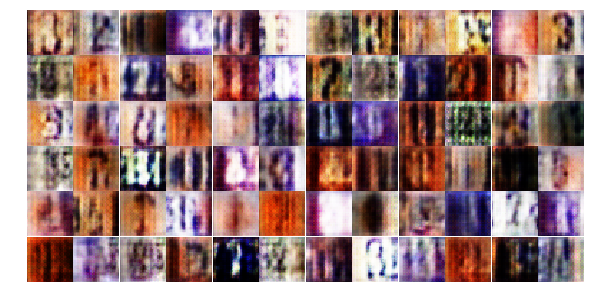

Epoch 9/20... Discriminator Loss: 0.3369... Generator Loss: 6.4464
Epoch 9/20... Discriminator Loss: 0.2278... Generator Loss: 2.2465
Epoch 9/20... Discriminator Loss: 0.1545... Generator Loss: 7.5617
Epoch 9/20... Discriminator Loss: 0.1457... Generator Loss: 4.0701
Epoch 9/20... Discriminator Loss: 1.2195... Generator Loss: 8.0561
Epoch 9/20... Discriminator Loss: 2.6877... Generator Loss: 0.1254
Epoch 9/20... Discriminator Loss: 0.2887... Generator Loss: 1.8957
Epoch 9/20... Discriminator Loss: 0.3100... Generator Loss: 1.8189
Epoch 9/20... Discriminator Loss: 0.4935... Generator Loss: 1.3414
Epoch 9/20... Discriminator Loss: 1.5032... Generator Loss: 5.4741


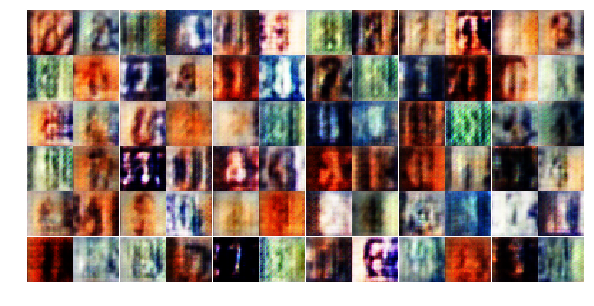

Epoch 9/20... Discriminator Loss: 0.7117... Generator Loss: 1.1641
Epoch 9/20... Discriminator Loss: 0.2967... Generator Loss: 1.8337
Epoch 9/20... Discriminator Loss: 0.6118... Generator Loss: 1.1037
Epoch 9/20... Discriminator Loss: 0.2418... Generator Loss: 1.9886
Epoch 9/20... Discriminator Loss: 0.2069... Generator Loss: 2.5391
Epoch 9/20... Discriminator Loss: 0.4794... Generator Loss: 1.1808
Epoch 9/20... Discriminator Loss: 0.7595... Generator Loss: 3.5545
Epoch 9/20... Discriminator Loss: 0.2700... Generator Loss: 2.4408
Epoch 9/20... Discriminator Loss: 0.3931... Generator Loss: 1.5079
Epoch 9/20... Discriminator Loss: 0.2419... Generator Loss: 2.2993


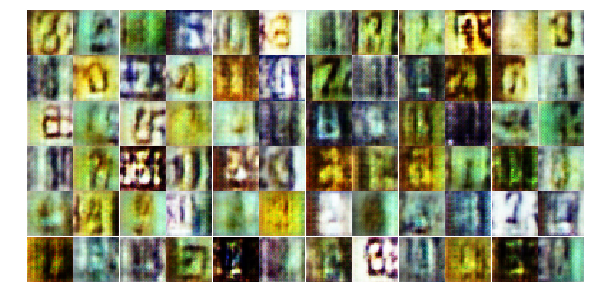

Epoch 9/20... Discriminator Loss: 0.0682... Generator Loss: 3.6345
Epoch 9/20... Discriminator Loss: 1.5784... Generator Loss: 0.3172
Epoch 9/20... Discriminator Loss: 0.7135... Generator Loss: 0.9105
Epoch 9/20... Discriminator Loss: 0.4813... Generator Loss: 3.9643
Epoch 9/20... Discriminator Loss: 0.5169... Generator Loss: 2.9349
Epoch 9/20... Discriminator Loss: 1.7112... Generator Loss: 0.2699
Epoch 9/20... Discriminator Loss: 0.3936... Generator Loss: 1.4443
Epoch 9/20... Discriminator Loss: 1.0294... Generator Loss: 0.6499
Epoch 9/20... Discriminator Loss: 0.6300... Generator Loss: 0.9927
Epoch 9/20... Discriminator Loss: 1.0039... Generator Loss: 0.7447


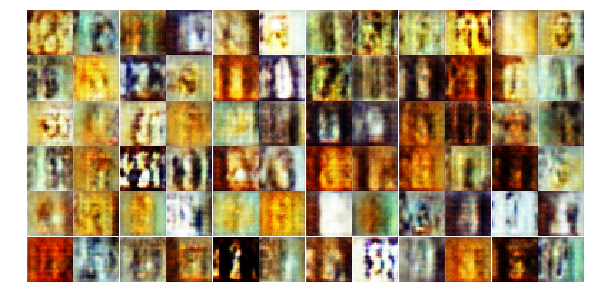

Epoch 9/20... Discriminator Loss: 0.2508... Generator Loss: 2.3913
Epoch 9/20... Discriminator Loss: 0.6062... Generator Loss: 1.0181
Epoch 9/20... Discriminator Loss: 0.2079... Generator Loss: 1.9861
Epoch 9/20... Discriminator Loss: 0.3314... Generator Loss: 1.6841
Epoch 9/20... Discriminator Loss: 0.1986... Generator Loss: 2.5854
Epoch 9/20... Discriminator Loss: 0.5794... Generator Loss: 2.3536
Epoch 9/20... Discriminator Loss: 0.6696... Generator Loss: 1.0505
Epoch 9/20... Discriminator Loss: 0.8925... Generator Loss: 0.7649
Epoch 9/20... Discriminator Loss: 0.7059... Generator Loss: 0.8801
Epoch 9/20... Discriminator Loss: 0.3421... Generator Loss: 2.6492


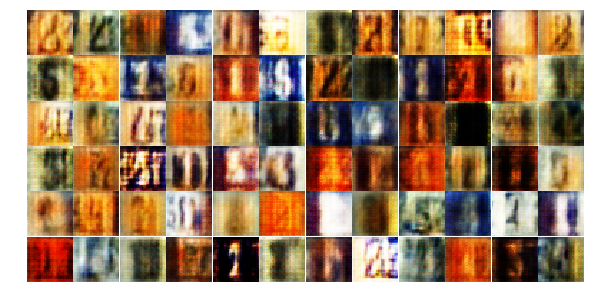

Epoch 9/20... Discriminator Loss: 0.7169... Generator Loss: 0.9336
Epoch 9/20... Discriminator Loss: 0.3360... Generator Loss: 2.0091
Epoch 9/20... Discriminator Loss: 0.0924... Generator Loss: 5.1437
Epoch 9/20... Discriminator Loss: 0.8649... Generator Loss: 0.8227
Epoch 9/20... Discriminator Loss: 0.3108... Generator Loss: 1.8669
Epoch 9/20... Discriminator Loss: 0.1933... Generator Loss: 2.8929
Epoch 9/20... Discriminator Loss: 0.2498... Generator Loss: 2.1104
Epoch 9/20... Discriminator Loss: 0.4044... Generator Loss: 1.7187
Epoch 9/20... Discriminator Loss: 0.3741... Generator Loss: 2.2119
Epoch 9/20... Discriminator Loss: 0.1191... Generator Loss: 2.9838


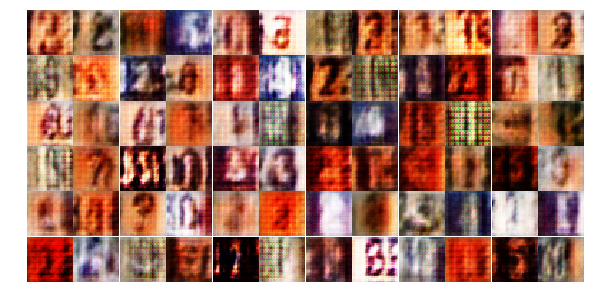

Epoch 9/20... Discriminator Loss: 0.4598... Generator Loss: 1.4583
Epoch 9/20... Discriminator Loss: 0.9109... Generator Loss: 0.7318
Epoch 9/20... Discriminator Loss: 0.3248... Generator Loss: 4.6694
Epoch 9/20... Discriminator Loss: 0.4316... Generator Loss: 1.6954
Epoch 9/20... Discriminator Loss: 0.3600... Generator Loss: 1.5204
Epoch 10/20... Discriminator Loss: 0.1746... Generator Loss: 2.5279
Epoch 10/20... Discriminator Loss: 0.4955... Generator Loss: 1.4770
Epoch 10/20... Discriminator Loss: 0.2085... Generator Loss: 2.1198
Epoch 10/20... Discriminator Loss: 0.8594... Generator Loss: 0.7617
Epoch 10/20... Discriminator Loss: 0.5584... Generator Loss: 3.9215


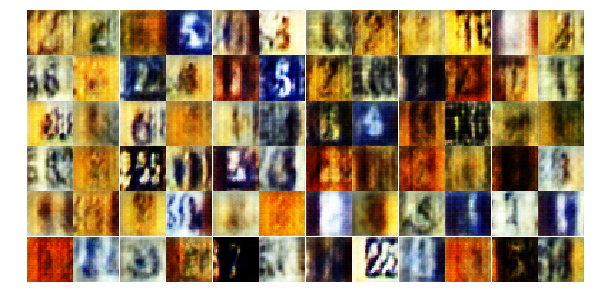

Epoch 10/20... Discriminator Loss: 1.3443... Generator Loss: 0.4813
Epoch 10/20... Discriminator Loss: 0.8363... Generator Loss: 0.8895
Epoch 10/20... Discriminator Loss: 0.1255... Generator Loss: 3.0136
Epoch 10/20... Discriminator Loss: 0.5465... Generator Loss: 1.4095
Epoch 10/20... Discriminator Loss: 0.9694... Generator Loss: 0.7626
Epoch 10/20... Discriminator Loss: 0.1957... Generator Loss: 2.5799
Epoch 10/20... Discriminator Loss: 0.0823... Generator Loss: 3.1332
Epoch 10/20... Discriminator Loss: 0.5138... Generator Loss: 4.3037
Epoch 10/20... Discriminator Loss: 0.1421... Generator Loss: 2.6997
Epoch 10/20... Discriminator Loss: 0.0890... Generator Loss: 3.3645


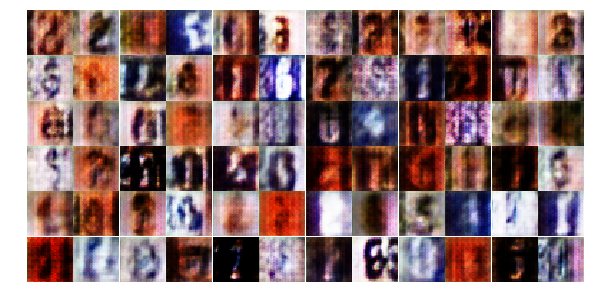

Epoch 10/20... Discriminator Loss: 0.1651... Generator Loss: 4.5941
Epoch 10/20... Discriminator Loss: 0.2701... Generator Loss: 3.7927
Epoch 10/20... Discriminator Loss: 0.2472... Generator Loss: 3.4445
Epoch 10/20... Discriminator Loss: 0.9142... Generator Loss: 0.8708
Epoch 10/20... Discriminator Loss: 0.1015... Generator Loss: 2.6780
Epoch 10/20... Discriminator Loss: 0.2992... Generator Loss: 2.6550
Epoch 10/20... Discriminator Loss: 0.4593... Generator Loss: 1.5362
Epoch 10/20... Discriminator Loss: 1.1407... Generator Loss: 0.5961
Epoch 10/20... Discriminator Loss: 1.0384... Generator Loss: 0.5848
Epoch 10/20... Discriminator Loss: 0.1722... Generator Loss: 2.2718


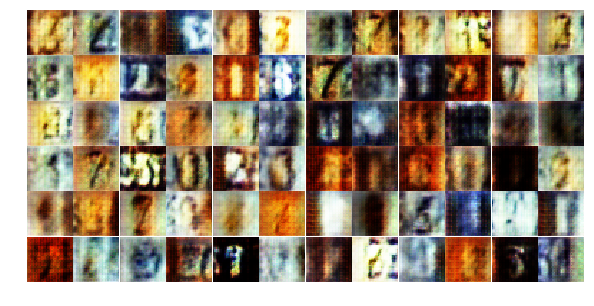

Epoch 10/20... Discriminator Loss: 0.3128... Generator Loss: 1.9617
Epoch 10/20... Discriminator Loss: 0.2268... Generator Loss: 2.4993
Epoch 10/20... Discriminator Loss: 0.2050... Generator Loss: 2.2382
Epoch 10/20... Discriminator Loss: 0.2957... Generator Loss: 1.7122
Epoch 10/20... Discriminator Loss: 0.4498... Generator Loss: 1.4721
Epoch 10/20... Discriminator Loss: 0.2852... Generator Loss: 1.8439
Epoch 10/20... Discriminator Loss: 0.6229... Generator Loss: 1.0775
Epoch 10/20... Discriminator Loss: 0.1707... Generator Loss: 5.4775
Epoch 10/20... Discriminator Loss: 0.1343... Generator Loss: 3.7458
Epoch 10/20... Discriminator Loss: 1.1775... Generator Loss: 0.5515


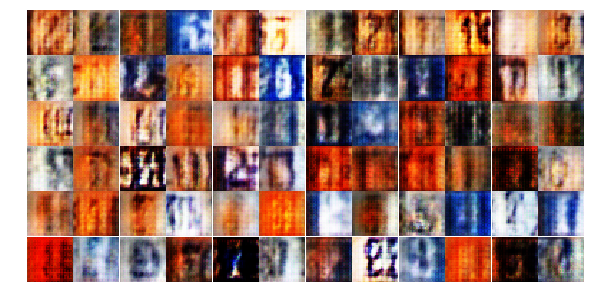

Epoch 10/20... Discriminator Loss: 0.4810... Generator Loss: 3.5142
Epoch 10/20... Discriminator Loss: 0.8537... Generator Loss: 0.9187
Epoch 10/20... Discriminator Loss: 0.2496... Generator Loss: 4.0259
Epoch 10/20... Discriminator Loss: 0.1522... Generator Loss: 5.2021
Epoch 10/20... Discriminator Loss: 0.2674... Generator Loss: 2.0721
Epoch 10/20... Discriminator Loss: 0.2991... Generator Loss: 1.7691
Epoch 10/20... Discriminator Loss: 0.0473... Generator Loss: 7.6706
Epoch 10/20... Discriminator Loss: 0.0962... Generator Loss: 3.9376
Epoch 10/20... Discriminator Loss: 0.2224... Generator Loss: 2.8288
Epoch 10/20... Discriminator Loss: 0.2654... Generator Loss: 2.0063


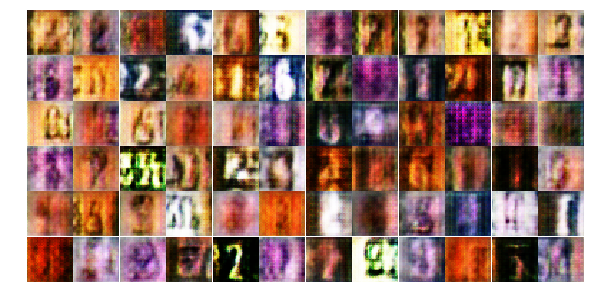

Epoch 10/20... Discriminator Loss: 0.3742... Generator Loss: 1.7094
Epoch 10/20... Discriminator Loss: 0.7685... Generator Loss: 0.8855
Epoch 10/20... Discriminator Loss: 2.1964... Generator Loss: 0.1891
Epoch 10/20... Discriminator Loss: 0.6235... Generator Loss: 1.0219
Epoch 10/20... Discriminator Loss: 0.2142... Generator Loss: 2.2002
Epoch 10/20... Discriminator Loss: 0.2300... Generator Loss: 1.8444
Epoch 10/20... Discriminator Loss: 0.1857... Generator Loss: 2.3478
Epoch 10/20... Discriminator Loss: 0.0475... Generator Loss: 4.2014
Epoch 10/20... Discriminator Loss: 0.1441... Generator Loss: 2.5254
Epoch 10/20... Discriminator Loss: 0.2515... Generator Loss: 1.8304


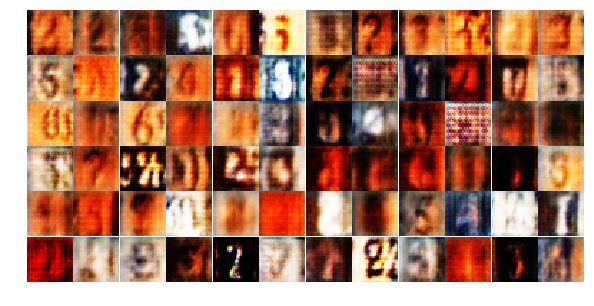

Epoch 10/20... Discriminator Loss: 0.1950... Generator Loss: 2.7091
Epoch 10/20... Discriminator Loss: 1.0266... Generator Loss: 0.8958
Epoch 10/20... Discriminator Loss: 1.3715... Generator Loss: 0.5892
Epoch 11/20... Discriminator Loss: 0.2650... Generator Loss: 2.9031
Epoch 11/20... Discriminator Loss: 1.0770... Generator Loss: 0.6429
Epoch 11/20... Discriminator Loss: 0.2937... Generator Loss: 3.4546
Epoch 11/20... Discriminator Loss: 0.3451... Generator Loss: 1.5564
Epoch 11/20... Discriminator Loss: 0.1020... Generator Loss: 2.9817
Epoch 11/20... Discriminator Loss: 1.2019... Generator Loss: 0.5841
Epoch 11/20... Discriminator Loss: 0.1798... Generator Loss: 3.1067


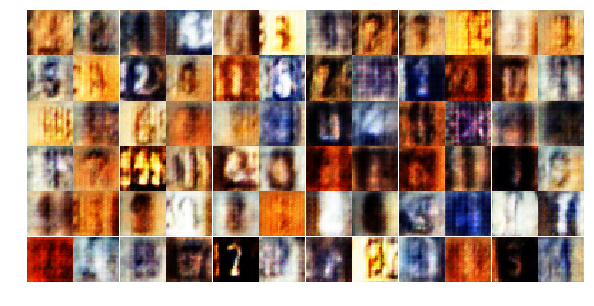

Epoch 11/20... Discriminator Loss: 0.2617... Generator Loss: 1.7525
Epoch 11/20... Discriminator Loss: 0.5134... Generator Loss: 1.3127
Epoch 11/20... Discriminator Loss: 0.1223... Generator Loss: 5.4511
Epoch 11/20... Discriminator Loss: 0.3785... Generator Loss: 2.5916
Epoch 11/20... Discriminator Loss: 1.4985... Generator Loss: 0.4963
Epoch 11/20... Discriminator Loss: 0.2597... Generator Loss: 1.9547
Epoch 11/20... Discriminator Loss: 0.2445... Generator Loss: 2.0606
Epoch 11/20... Discriminator Loss: 0.0658... Generator Loss: 4.0991
Epoch 11/20... Discriminator Loss: 0.1563... Generator Loss: 6.2559
Epoch 11/20... Discriminator Loss: 0.1535... Generator Loss: 2.8903


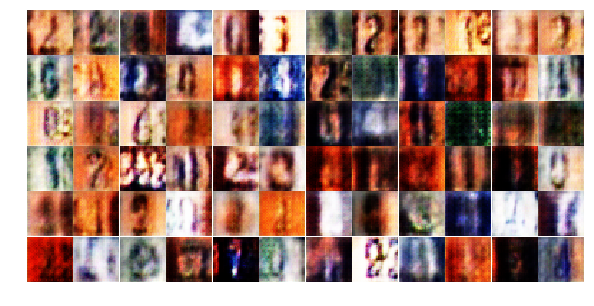

Epoch 11/20... Discriminator Loss: 0.4597... Generator Loss: 1.4100
Epoch 11/20... Discriminator Loss: 0.2576... Generator Loss: 3.9625
Epoch 11/20... Discriminator Loss: 0.7828... Generator Loss: 0.9214
Epoch 11/20... Discriminator Loss: 0.1197... Generator Loss: 2.9991
Epoch 11/20... Discriminator Loss: 0.0622... Generator Loss: 3.8475
Epoch 11/20... Discriminator Loss: 0.0981... Generator Loss: 3.2859
Epoch 11/20... Discriminator Loss: 0.1540... Generator Loss: 2.7759
Epoch 11/20... Discriminator Loss: 3.4053... Generator Loss: 0.0605
Epoch 11/20... Discriminator Loss: 0.6888... Generator Loss: 1.0655
Epoch 11/20... Discriminator Loss: 0.2345... Generator Loss: 2.8185


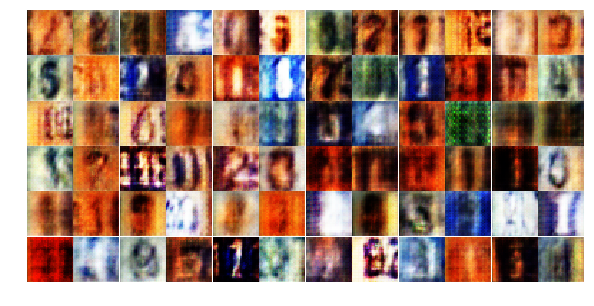

Epoch 11/20... Discriminator Loss: 0.7673... Generator Loss: 0.9971
Epoch 11/20... Discriminator Loss: 0.2897... Generator Loss: 2.0807
Epoch 11/20... Discriminator Loss: 0.2571... Generator Loss: 5.9797
Epoch 11/20... Discriminator Loss: 0.3168... Generator Loss: 1.6243
Epoch 11/20... Discriminator Loss: 0.3100... Generator Loss: 5.1902
Epoch 11/20... Discriminator Loss: 0.4316... Generator Loss: 1.4943
Epoch 11/20... Discriminator Loss: 0.4504... Generator Loss: 7.9461
Epoch 11/20... Discriminator Loss: 0.4159... Generator Loss: 1.5702
Epoch 11/20... Discriminator Loss: 0.1094... Generator Loss: 3.4326
Epoch 11/20... Discriminator Loss: 1.1343... Generator Loss: 4.3818


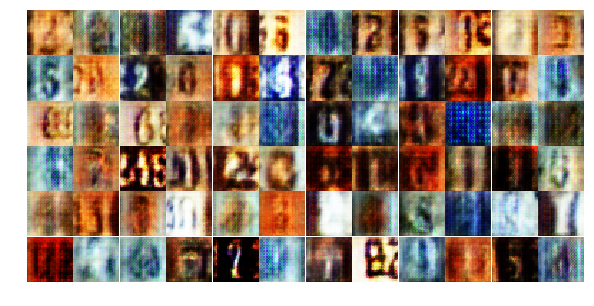

Epoch 11/20... Discriminator Loss: 0.1652... Generator Loss: 2.5111
Epoch 11/20... Discriminator Loss: 0.1410... Generator Loss: 3.2779
Epoch 11/20... Discriminator Loss: 0.6361... Generator Loss: 1.1724
Epoch 11/20... Discriminator Loss: 0.3190... Generator Loss: 1.7206
Epoch 11/20... Discriminator Loss: 0.2617... Generator Loss: 1.8554
Epoch 11/20... Discriminator Loss: 0.7428... Generator Loss: 0.8270
Epoch 11/20... Discriminator Loss: 0.1769... Generator Loss: 2.5924
Epoch 11/20... Discriminator Loss: 0.8212... Generator Loss: 0.9551
Epoch 11/20... Discriminator Loss: 0.7580... Generator Loss: 0.8573
Epoch 11/20... Discriminator Loss: 0.9786... Generator Loss: 0.7221


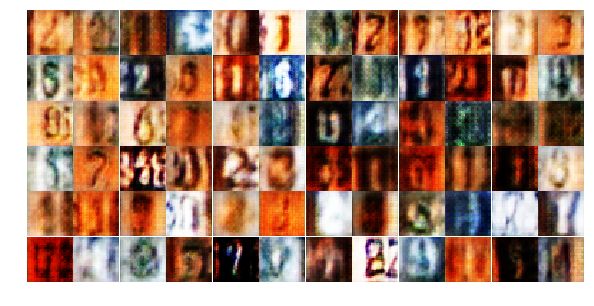

Epoch 11/20... Discriminator Loss: 0.2466... Generator Loss: 3.5673
Epoch 11/20... Discriminator Loss: 0.9442... Generator Loss: 0.7049
Epoch 11/20... Discriminator Loss: 0.2061... Generator Loss: 2.1925
Epoch 11/20... Discriminator Loss: 1.5347... Generator Loss: 0.4001
Epoch 11/20... Discriminator Loss: 0.1068... Generator Loss: 3.8111
Epoch 11/20... Discriminator Loss: 0.0826... Generator Loss: 3.5520
Epoch 11/20... Discriminator Loss: 0.3151... Generator Loss: 2.6615
Epoch 11/20... Discriminator Loss: 0.2635... Generator Loss: 2.4191
Epoch 11/20... Discriminator Loss: 0.3342... Generator Loss: 1.7421
Epoch 11/20... Discriminator Loss: 0.0781... Generator Loss: 3.4181


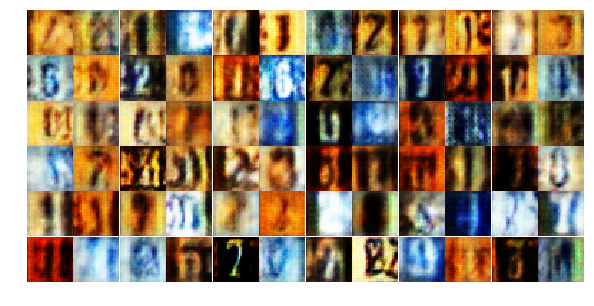

Epoch 12/20... Discriminator Loss: 0.0797... Generator Loss: 3.3519
Epoch 12/20... Discriminator Loss: 0.9458... Generator Loss: 0.6643
Epoch 12/20... Discriminator Loss: 0.0946... Generator Loss: 4.2273
Epoch 12/20... Discriminator Loss: 0.3431... Generator Loss: 2.6888
Epoch 12/20... Discriminator Loss: 0.1676... Generator Loss: 2.9998
Epoch 12/20... Discriminator Loss: 0.2167... Generator Loss: 5.1443
Epoch 12/20... Discriminator Loss: 0.1320... Generator Loss: 2.4880
Epoch 12/20... Discriminator Loss: 0.1579... Generator Loss: 6.9469
Epoch 12/20... Discriminator Loss: 0.5775... Generator Loss: 1.1426
Epoch 12/20... Discriminator Loss: 0.0514... Generator Loss: 3.8535


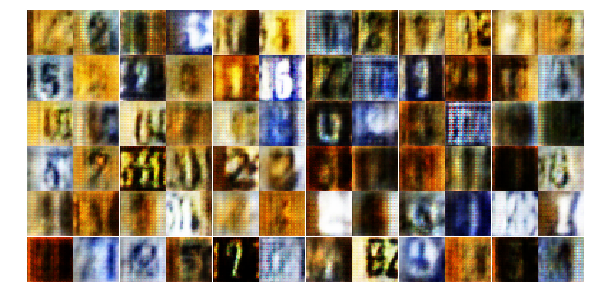

Epoch 12/20... Discriminator Loss: 0.2225... Generator Loss: 4.2309
Epoch 12/20... Discriminator Loss: 0.3409... Generator Loss: 1.5465
Epoch 12/20... Discriminator Loss: 0.2485... Generator Loss: 2.1937
Epoch 12/20... Discriminator Loss: 0.2016... Generator Loss: 2.5574
Epoch 12/20... Discriminator Loss: 0.4847... Generator Loss: 1.3923
Epoch 12/20... Discriminator Loss: 0.2846... Generator Loss: 1.8163
Epoch 12/20... Discriminator Loss: 2.9918... Generator Loss: 0.1512
Epoch 12/20... Discriminator Loss: 0.0721... Generator Loss: 3.2952
Epoch 12/20... Discriminator Loss: 0.0679... Generator Loss: 3.3047
Epoch 12/20... Discriminator Loss: 0.5422... Generator Loss: 1.5448


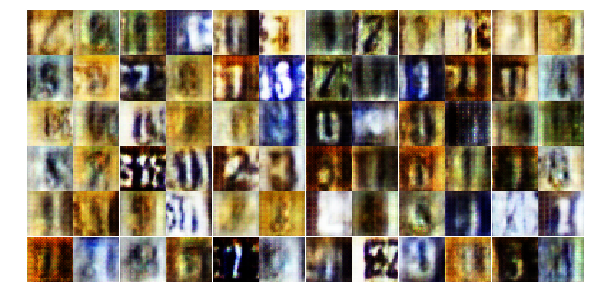

Epoch 12/20... Discriminator Loss: 0.0388... Generator Loss: 5.2321
Epoch 12/20... Discriminator Loss: 0.0989... Generator Loss: 2.7734
Epoch 12/20... Discriminator Loss: 1.0343... Generator Loss: 0.6396
Epoch 12/20... Discriminator Loss: 0.4172... Generator Loss: 1.3470
Epoch 12/20... Discriminator Loss: 0.0425... Generator Loss: 5.2119
Epoch 12/20... Discriminator Loss: 0.1293... Generator Loss: 3.9166
Epoch 12/20... Discriminator Loss: 1.2104... Generator Loss: 0.5562
Epoch 12/20... Discriminator Loss: 0.3627... Generator Loss: 1.5616
Epoch 12/20... Discriminator Loss: 0.1277... Generator Loss: 4.4090
Epoch 12/20... Discriminator Loss: 2.2321... Generator Loss: 0.2198


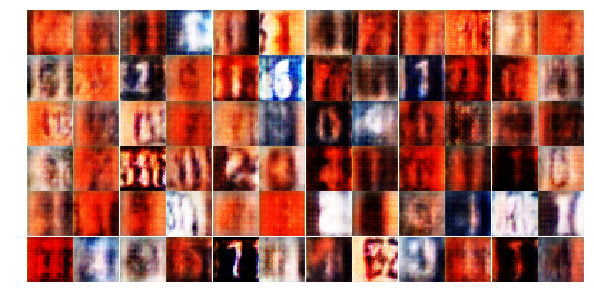

Epoch 12/20... Discriminator Loss: 0.1462... Generator Loss: 2.8533
Epoch 12/20... Discriminator Loss: 1.2688... Generator Loss: 0.5460
Epoch 12/20... Discriminator Loss: 1.8450... Generator Loss: 0.2882
Epoch 12/20... Discriminator Loss: 0.3076... Generator Loss: 1.8512
Epoch 12/20... Discriminator Loss: 0.1873... Generator Loss: 2.7693
Epoch 12/20... Discriminator Loss: 0.2480... Generator Loss: 1.8726
Epoch 12/20... Discriminator Loss: 0.2621... Generator Loss: 3.9452
Epoch 12/20... Discriminator Loss: 1.3878... Generator Loss: 0.4505
Epoch 12/20... Discriminator Loss: 0.0685... Generator Loss: 4.6079
Epoch 12/20... Discriminator Loss: 0.1091... Generator Loss: 3.0587


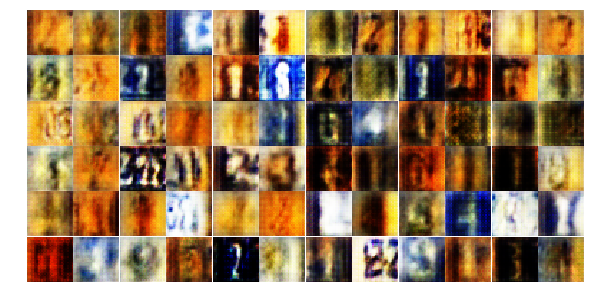

Epoch 12/20... Discriminator Loss: 0.1831... Generator Loss: 2.5045
Epoch 12/20... Discriminator Loss: 0.4350... Generator Loss: 1.3755
Epoch 12/20... Discriminator Loss: 0.5326... Generator Loss: 1.1141
Epoch 12/20... Discriminator Loss: 0.3076... Generator Loss: 1.7430
Epoch 12/20... Discriminator Loss: 0.1307... Generator Loss: 3.6914
Epoch 12/20... Discriminator Loss: 0.9733... Generator Loss: 0.6585
Epoch 12/20... Discriminator Loss: 0.2171... Generator Loss: 2.2336
Epoch 12/20... Discriminator Loss: 0.1310... Generator Loss: 2.6837
Epoch 12/20... Discriminator Loss: 0.1429... Generator Loss: 4.7336
Epoch 12/20... Discriminator Loss: 1.6091... Generator Loss: 0.4355


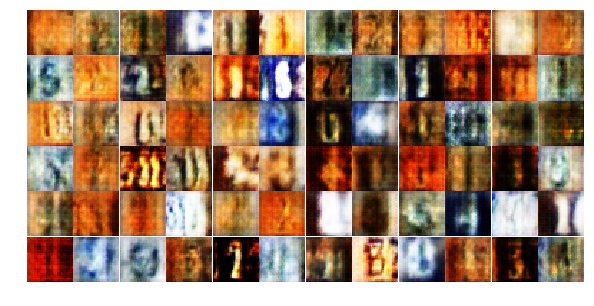

Epoch 12/20... Discriminator Loss: 0.7443... Generator Loss: 0.9781
Epoch 12/20... Discriminator Loss: 0.7401... Generator Loss: 0.9313
Epoch 12/20... Discriminator Loss: 0.7088... Generator Loss: 2.1590
Epoch 12/20... Discriminator Loss: 0.3188... Generator Loss: 3.3506
Epoch 12/20... Discriminator Loss: 0.0467... Generator Loss: 4.0202
Epoch 12/20... Discriminator Loss: 0.1048... Generator Loss: 4.1902
Epoch 12/20... Discriminator Loss: 0.1624... Generator Loss: 2.7796
Epoch 13/20... Discriminator Loss: 0.0843... Generator Loss: 4.7175
Epoch 13/20... Discriminator Loss: 0.1934... Generator Loss: 4.8352
Epoch 13/20... Discriminator Loss: 0.1767... Generator Loss: 3.7941


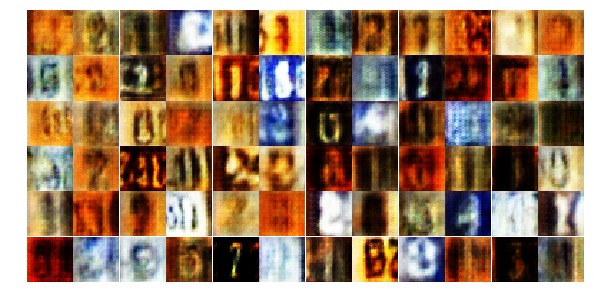

Epoch 13/20... Discriminator Loss: 0.4695... Generator Loss: 1.5498
Epoch 13/20... Discriminator Loss: 0.4990... Generator Loss: 2.7224
Epoch 13/20... Discriminator Loss: 0.9240... Generator Loss: 0.7118
Epoch 13/20... Discriminator Loss: 0.8564... Generator Loss: 1.0331
Epoch 13/20... Discriminator Loss: 0.3663... Generator Loss: 1.7008
Epoch 13/20... Discriminator Loss: 0.3601... Generator Loss: 3.8755
Epoch 13/20... Discriminator Loss: 0.1079... Generator Loss: 2.8751
Epoch 13/20... Discriminator Loss: 1.3646... Generator Loss: 0.4842
Epoch 13/20... Discriminator Loss: 0.8490... Generator Loss: 0.8003
Epoch 13/20... Discriminator Loss: 0.3196... Generator Loss: 1.8638


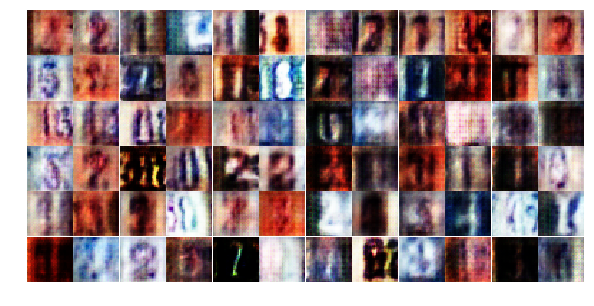

Epoch 13/20... Discriminator Loss: 0.3925... Generator Loss: 1.7739
Epoch 13/20... Discriminator Loss: 0.0874... Generator Loss: 5.2749
Epoch 13/20... Discriminator Loss: 1.0577... Generator Loss: 0.6272
Epoch 13/20... Discriminator Loss: 0.9867... Generator Loss: 0.6629
Epoch 13/20... Discriminator Loss: 0.3520... Generator Loss: 1.5025
Epoch 13/20... Discriminator Loss: 0.4389... Generator Loss: 4.5935
Epoch 13/20... Discriminator Loss: 0.1236... Generator Loss: 2.8001
Epoch 13/20... Discriminator Loss: 0.2205... Generator Loss: 2.3086
Epoch 13/20... Discriminator Loss: 0.5281... Generator Loss: 1.1439
Epoch 13/20... Discriminator Loss: 0.3958... Generator Loss: 1.5461


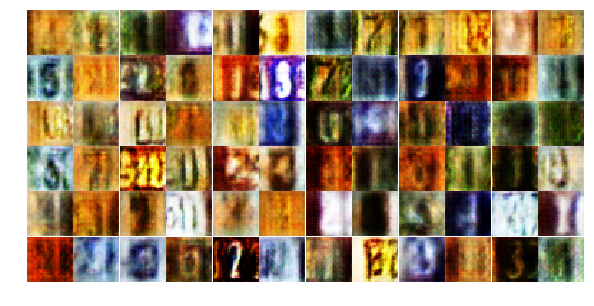

Epoch 13/20... Discriminator Loss: 0.5568... Generator Loss: 1.3685
Epoch 13/20... Discriminator Loss: 0.1664... Generator Loss: 3.2980
Epoch 13/20... Discriminator Loss: 0.7067... Generator Loss: 1.0113
Epoch 13/20... Discriminator Loss: 1.2801... Generator Loss: 0.4292
Epoch 13/20... Discriminator Loss: 0.3280... Generator Loss: 1.8648
Epoch 13/20... Discriminator Loss: 0.3886... Generator Loss: 1.6663
Epoch 13/20... Discriminator Loss: 0.7870... Generator Loss: 0.8001
Epoch 13/20... Discriminator Loss: 1.5501... Generator Loss: 0.5658
Epoch 13/20... Discriminator Loss: 0.1208... Generator Loss: 2.8622
Epoch 13/20... Discriminator Loss: 0.1178... Generator Loss: 5.9230


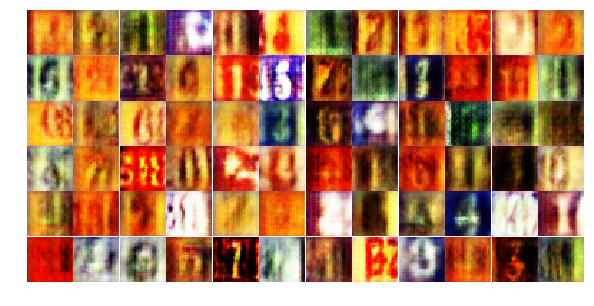

Epoch 13/20... Discriminator Loss: 1.8266... Generator Loss: 0.2908
Epoch 13/20... Discriminator Loss: 1.2578... Generator Loss: 0.4596
Epoch 13/20... Discriminator Loss: 0.2946... Generator Loss: 2.4411
Epoch 13/20... Discriminator Loss: 0.7031... Generator Loss: 6.6145
Epoch 13/20... Discriminator Loss: 0.1410... Generator Loss: 3.2485
Epoch 13/20... Discriminator Loss: 0.3093... Generator Loss: 1.6652
Epoch 13/20... Discriminator Loss: 0.2337... Generator Loss: 2.0159
Epoch 13/20... Discriminator Loss: 1.0943... Generator Loss: 0.6485
Epoch 13/20... Discriminator Loss: 0.1795... Generator Loss: 2.4468
Epoch 13/20... Discriminator Loss: 0.5210... Generator Loss: 1.3379


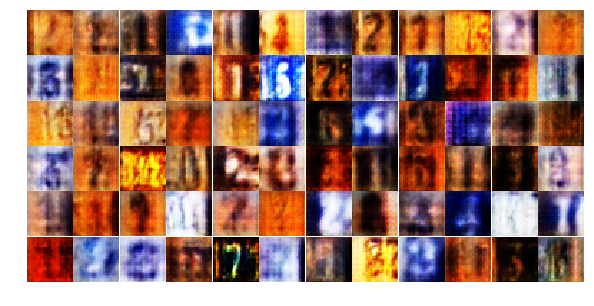

Epoch 13/20... Discriminator Loss: 0.1123... Generator Loss: 4.3878
Epoch 13/20... Discriminator Loss: 0.7747... Generator Loss: 0.7932
Epoch 13/20... Discriminator Loss: 0.1818... Generator Loss: 3.2646
Epoch 13/20... Discriminator Loss: 0.2478... Generator Loss: 1.8716
Epoch 13/20... Discriminator Loss: 0.9661... Generator Loss: 0.6648
Epoch 13/20... Discriminator Loss: 0.2414... Generator Loss: 2.3186
Epoch 13/20... Discriminator Loss: 0.4461... Generator Loss: 1.4470
Epoch 13/20... Discriminator Loss: 0.1778... Generator Loss: 2.4528
Epoch 13/20... Discriminator Loss: 0.1928... Generator Loss: 2.3791
Epoch 13/20... Discriminator Loss: 0.1353... Generator Loss: 2.8040


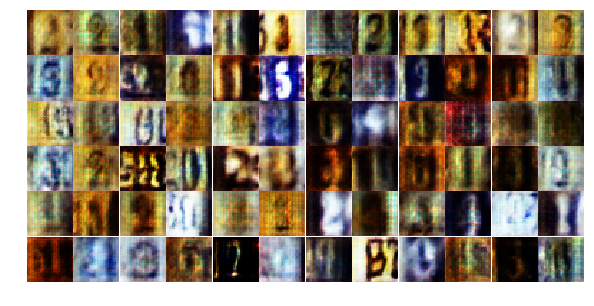

Epoch 13/20... Discriminator Loss: 0.2431... Generator Loss: 9.2867
Epoch 13/20... Discriminator Loss: 0.1340... Generator Loss: 5.4798
Epoch 13/20... Discriminator Loss: 0.2717... Generator Loss: 2.4425
Epoch 13/20... Discriminator Loss: 0.0875... Generator Loss: 3.6293
Epoch 14/20... Discriminator Loss: 0.1722... Generator Loss: 3.1693
Epoch 14/20... Discriminator Loss: 0.4312... Generator Loss: 1.4598
Epoch 14/20... Discriminator Loss: 0.5152... Generator Loss: 1.2825
Epoch 14/20... Discriminator Loss: 0.0436... Generator Loss: 3.7842
Epoch 14/20... Discriminator Loss: 0.9413... Generator Loss: 0.6639
Epoch 14/20... Discriminator Loss: 0.2036... Generator Loss: 2.4313


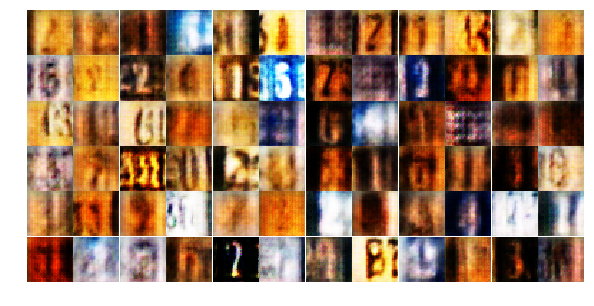

Epoch 14/20... Discriminator Loss: 0.5799... Generator Loss: 1.1141
Epoch 14/20... Discriminator Loss: 0.5570... Generator Loss: 1.1181
Epoch 14/20... Discriminator Loss: 0.2710... Generator Loss: 2.0556
Epoch 14/20... Discriminator Loss: 0.1330... Generator Loss: 4.2075
Epoch 14/20... Discriminator Loss: 0.3436... Generator Loss: 1.9248
Epoch 14/20... Discriminator Loss: 0.7661... Generator Loss: 0.8880
Epoch 14/20... Discriminator Loss: 0.0954... Generator Loss: 3.9395
Epoch 14/20... Discriminator Loss: 2.2045... Generator Loss: 0.1896
Epoch 14/20... Discriminator Loss: 0.8121... Generator Loss: 0.8948
Epoch 14/20... Discriminator Loss: 0.3052... Generator Loss: 1.9718


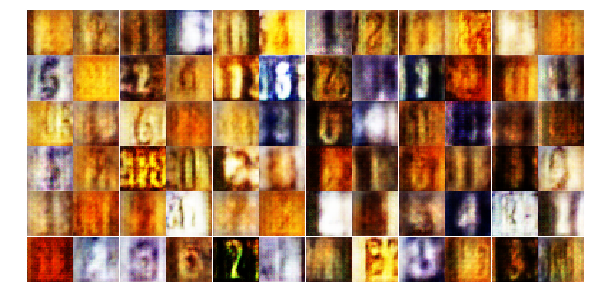

Epoch 14/20... Discriminator Loss: 0.1230... Generator Loss: 2.7667
Epoch 14/20... Discriminator Loss: 0.0977... Generator Loss: 2.9170
Epoch 14/20... Discriminator Loss: 0.5877... Generator Loss: 1.1634
Epoch 14/20... Discriminator Loss: 0.1467... Generator Loss: 6.9646
Epoch 14/20... Discriminator Loss: 0.4067... Generator Loss: 1.4223
Epoch 14/20... Discriminator Loss: 2.3452... Generator Loss: 0.2198
Epoch 14/20... Discriminator Loss: 0.4915... Generator Loss: 1.3985
Epoch 14/20... Discriminator Loss: 0.8863... Generator Loss: 0.8998
Epoch 14/20... Discriminator Loss: 2.2046... Generator Loss: 0.1925
Epoch 14/20... Discriminator Loss: 1.6416... Generator Loss: 0.3680


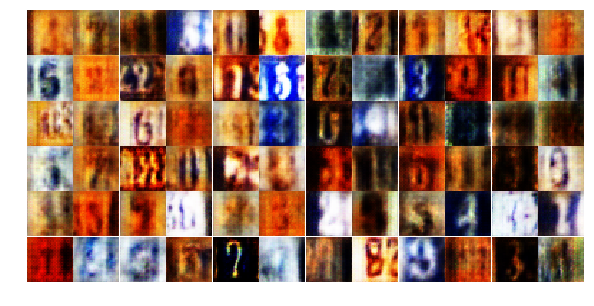

Epoch 14/20... Discriminator Loss: 0.0970... Generator Loss: 3.1764
Epoch 14/20... Discriminator Loss: 0.2129... Generator Loss: 2.4470
Epoch 14/20... Discriminator Loss: 0.1839... Generator Loss: 5.4426
Epoch 14/20... Discriminator Loss: 0.4788... Generator Loss: 1.3467
Epoch 14/20... Discriminator Loss: 0.1630... Generator Loss: 2.7821
Epoch 14/20... Discriminator Loss: 0.6028... Generator Loss: 1.0986
Epoch 14/20... Discriminator Loss: 0.1048... Generator Loss: 4.5841
Epoch 14/20... Discriminator Loss: 0.8494... Generator Loss: 0.8062
Epoch 14/20... Discriminator Loss: 0.9141... Generator Loss: 0.8908
Epoch 14/20... Discriminator Loss: 1.9060... Generator Loss: 0.2611


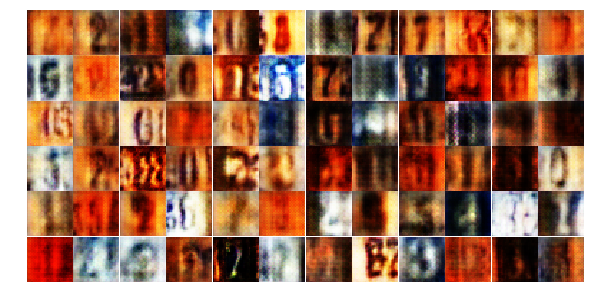

Epoch 14/20... Discriminator Loss: 0.5526... Generator Loss: 1.2812
Epoch 14/20... Discriminator Loss: 0.3817... Generator Loss: 1.7239
Epoch 14/20... Discriminator Loss: 0.1094... Generator Loss: 3.5243
Epoch 14/20... Discriminator Loss: 2.5552... Generator Loss: 0.1755
Epoch 14/20... Discriminator Loss: 0.6873... Generator Loss: 1.0733
Epoch 14/20... Discriminator Loss: 0.4745... Generator Loss: 1.4431
Epoch 14/20... Discriminator Loss: 0.8372... Generator Loss: 0.8177
Epoch 14/20... Discriminator Loss: 0.1801... Generator Loss: 2.4256
Epoch 14/20... Discriminator Loss: 0.1718... Generator Loss: 2.7669
Epoch 14/20... Discriminator Loss: 0.3004... Generator Loss: 3.1448


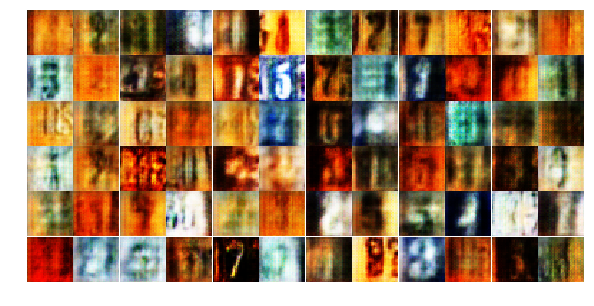

Epoch 14/20... Discriminator Loss: 0.4209... Generator Loss: 1.4434
Epoch 14/20... Discriminator Loss: 1.6855... Generator Loss: 0.4175
Epoch 14/20... Discriminator Loss: 0.6609... Generator Loss: 1.0477
Epoch 14/20... Discriminator Loss: 0.3424... Generator Loss: 1.7574
Epoch 14/20... Discriminator Loss: 0.1834... Generator Loss: 2.3359
Epoch 14/20... Discriminator Loss: 0.3144... Generator Loss: 2.1038
Epoch 14/20... Discriminator Loss: 0.2572... Generator Loss: 3.4569
Epoch 14/20... Discriminator Loss: 1.7189... Generator Loss: 0.4335
Epoch 14/20... Discriminator Loss: 0.1214... Generator Loss: 4.4411
Epoch 14/20... Discriminator Loss: 0.0912... Generator Loss: 4.1160


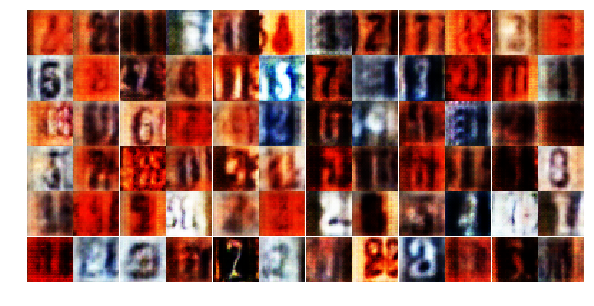

Epoch 14/20... Discriminator Loss: 0.4322... Generator Loss: 1.2853
Epoch 14/20... Discriminator Loss: 0.8515... Generator Loss: 0.8319
Epoch 15/20... Discriminator Loss: 0.8434... Generator Loss: 0.9094
Epoch 15/20... Discriminator Loss: 1.4662... Generator Loss: 0.5465
Epoch 15/20... Discriminator Loss: 0.0973... Generator Loss: 4.0826
Epoch 15/20... Discriminator Loss: 0.4956... Generator Loss: 1.1971
Epoch 15/20... Discriminator Loss: 0.2186... Generator Loss: 2.6785
Epoch 15/20... Discriminator Loss: 0.0923... Generator Loss: 3.2016
Epoch 15/20... Discriminator Loss: 0.0414... Generator Loss: 4.4016
Epoch 15/20... Discriminator Loss: 0.4865... Generator Loss: 1.4998


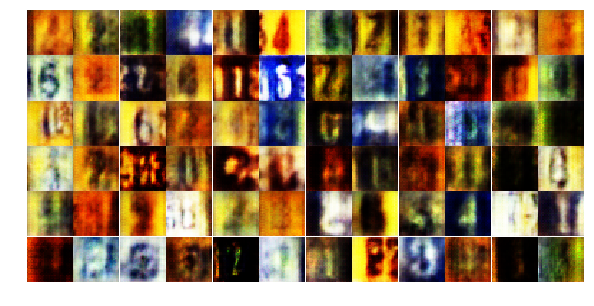

Epoch 15/20... Discriminator Loss: 0.7484... Generator Loss: 8.3551
Epoch 15/20... Discriminator Loss: 1.1508... Generator Loss: 0.6873
Epoch 15/20... Discriminator Loss: 1.3409... Generator Loss: 0.4877
Epoch 15/20... Discriminator Loss: 0.5868... Generator Loss: 1.2468
Epoch 15/20... Discriminator Loss: 0.9223... Generator Loss: 0.6823
Epoch 15/20... Discriminator Loss: 0.4187... Generator Loss: 1.3220
Epoch 15/20... Discriminator Loss: 0.9082... Generator Loss: 0.7519
Epoch 15/20... Discriminator Loss: 0.8479... Generator Loss: 0.7818
Epoch 15/20... Discriminator Loss: 1.1896... Generator Loss: 0.5935
Epoch 15/20... Discriminator Loss: 0.0731... Generator Loss: 4.3159


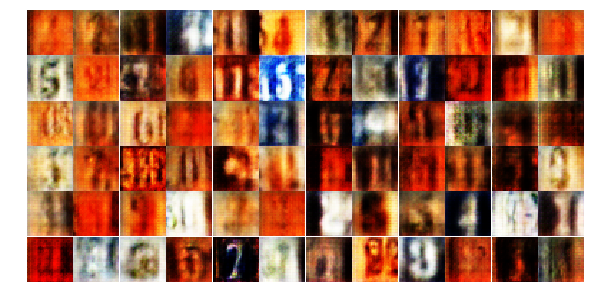

Epoch 15/20... Discriminator Loss: 0.5425... Generator Loss: 1.2328
Epoch 15/20... Discriminator Loss: 0.7626... Generator Loss: 0.9229
Epoch 15/20... Discriminator Loss: 0.1972... Generator Loss: 2.2335
Epoch 15/20... Discriminator Loss: 1.3537... Generator Loss: 0.4915
Epoch 15/20... Discriminator Loss: 0.5237... Generator Loss: 1.2783
Epoch 15/20... Discriminator Loss: 0.4665... Generator Loss: 7.3577
Epoch 15/20... Discriminator Loss: 0.1830... Generator Loss: 2.9691
Epoch 15/20... Discriminator Loss: 0.3488... Generator Loss: 2.2392
Epoch 15/20... Discriminator Loss: 0.2529... Generator Loss: 7.4327
Epoch 15/20... Discriminator Loss: 0.3869... Generator Loss: 1.6856


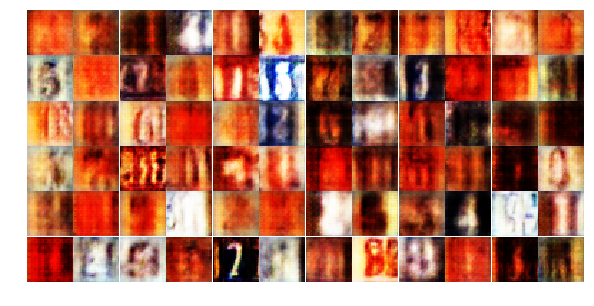

Epoch 15/20... Discriminator Loss: 0.1813... Generator Loss: 2.6403
Epoch 15/20... Discriminator Loss: 0.6782... Generator Loss: 2.8470
Epoch 15/20... Discriminator Loss: 0.2745... Generator Loss: 1.9451
Epoch 15/20... Discriminator Loss: 1.3428... Generator Loss: 0.4547
Epoch 15/20... Discriminator Loss: 1.1617... Generator Loss: 0.6695
Epoch 15/20... Discriminator Loss: 0.7928... Generator Loss: 0.9057
Epoch 15/20... Discriminator Loss: 0.2838... Generator Loss: 4.9738
Epoch 15/20... Discriminator Loss: 0.8301... Generator Loss: 0.8571
Epoch 15/20... Discriminator Loss: 0.2938... Generator Loss: 1.7091
Epoch 15/20... Discriminator Loss: 1.7959... Generator Loss: 0.2938


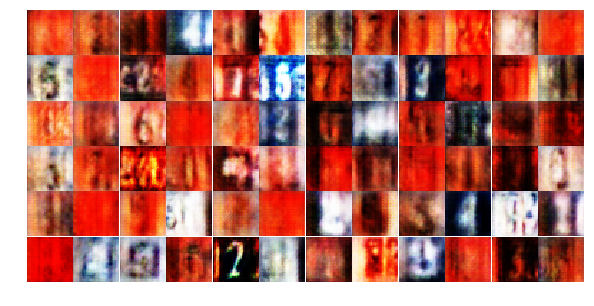

Epoch 15/20... Discriminator Loss: 0.2684... Generator Loss: 2.3857
Epoch 15/20... Discriminator Loss: 0.4078... Generator Loss: 1.5273
Epoch 15/20... Discriminator Loss: 0.8598... Generator Loss: 0.8501
Epoch 15/20... Discriminator Loss: 0.4482... Generator Loss: 1.2998
Epoch 15/20... Discriminator Loss: 0.3814... Generator Loss: 1.6736
Epoch 15/20... Discriminator Loss: 0.8018... Generator Loss: 1.2951
Epoch 15/20... Discriminator Loss: 0.4630... Generator Loss: 1.5503
Epoch 15/20... Discriminator Loss: 0.4808... Generator Loss: 1.2941
Epoch 15/20... Discriminator Loss: 0.4877... Generator Loss: 1.5058
Epoch 15/20... Discriminator Loss: 0.1011... Generator Loss: 4.5669


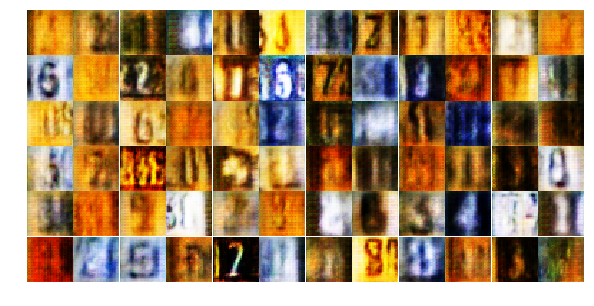

Epoch 15/20... Discriminator Loss: 0.0880... Generator Loss: 4.1842
Epoch 15/20... Discriminator Loss: 0.8574... Generator Loss: 0.9240
Epoch 15/20... Discriminator Loss: 0.1063... Generator Loss: 3.8181
Epoch 15/20... Discriminator Loss: 0.4592... Generator Loss: 2.3335
Epoch 15/20... Discriminator Loss: 0.0583... Generator Loss: 5.5912
Epoch 15/20... Discriminator Loss: 0.8116... Generator Loss: 1.1256
Epoch 15/20... Discriminator Loss: 0.4874... Generator Loss: 2.3428
Epoch 15/20... Discriminator Loss: 0.1936... Generator Loss: 2.4435
Epoch 15/20... Discriminator Loss: 0.2864... Generator Loss: 2.9217
Epoch 16/20... Discriminator Loss: 1.8229... Generator Loss: 0.3460


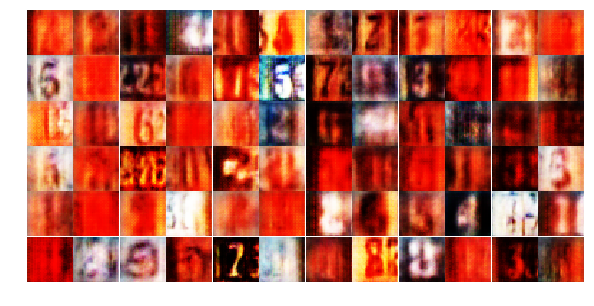

Epoch 16/20... Discriminator Loss: 0.0891... Generator Loss: 3.1329
Epoch 16/20... Discriminator Loss: 0.5124... Generator Loss: 1.3592
Epoch 16/20... Discriminator Loss: 0.3556... Generator Loss: 1.7234
Epoch 16/20... Discriminator Loss: 1.5489... Generator Loss: 5.7344
Epoch 16/20... Discriminator Loss: 0.0663... Generator Loss: 6.7294
Epoch 16/20... Discriminator Loss: 0.2918... Generator Loss: 2.3492
Epoch 16/20... Discriminator Loss: 1.2549... Generator Loss: 0.5662
Epoch 16/20... Discriminator Loss: 0.2488... Generator Loss: 2.3858
Epoch 16/20... Discriminator Loss: 0.1995... Generator Loss: 5.8401
Epoch 16/20... Discriminator Loss: 0.1604... Generator Loss: 2.4054


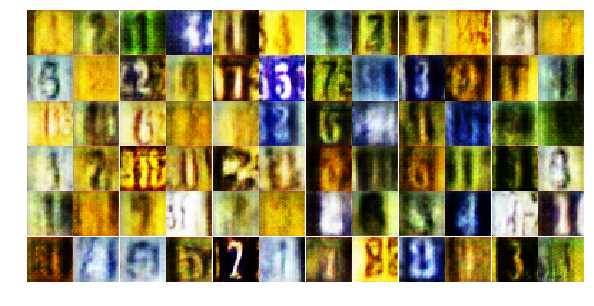

Epoch 16/20... Discriminator Loss: 1.3383... Generator Loss: 0.4353
Epoch 16/20... Discriminator Loss: 0.3963... Generator Loss: 1.6871
Epoch 16/20... Discriminator Loss: 0.0624... Generator Loss: 4.2815
Epoch 16/20... Discriminator Loss: 0.1338... Generator Loss: 4.1951
Epoch 16/20... Discriminator Loss: 0.4737... Generator Loss: 1.2994
Epoch 16/20... Discriminator Loss: 1.5795... Generator Loss: 0.4595
Epoch 16/20... Discriminator Loss: 2.6279... Generator Loss: 0.1295
Epoch 16/20... Discriminator Loss: 0.5674... Generator Loss: 1.1785
Epoch 16/20... Discriminator Loss: 0.5593... Generator Loss: 1.1192
Epoch 16/20... Discriminator Loss: 0.3940... Generator Loss: 1.5128


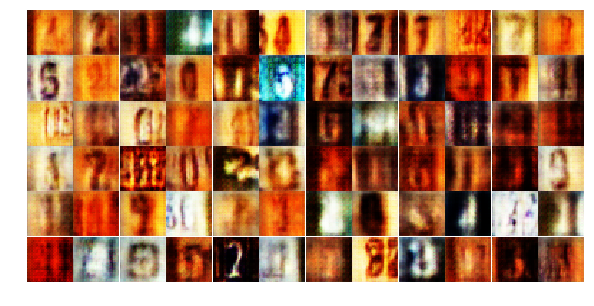

Epoch 16/20... Discriminator Loss: 0.1692... Generator Loss: 2.5801
Epoch 16/20... Discriminator Loss: 2.0873... Generator Loss: 0.3334
Epoch 16/20... Discriminator Loss: 1.3710... Generator Loss: 0.5667
Epoch 16/20... Discriminator Loss: 0.0982... Generator Loss: 6.1804
Epoch 16/20... Discriminator Loss: 2.3808... Generator Loss: 0.2232
Epoch 16/20... Discriminator Loss: 1.6517... Generator Loss: 0.4395
Epoch 16/20... Discriminator Loss: 0.9903... Generator Loss: 0.8061
Epoch 16/20... Discriminator Loss: 0.9222... Generator Loss: 0.7699
Epoch 16/20... Discriminator Loss: 0.4289... Generator Loss: 1.5504
Epoch 16/20... Discriminator Loss: 0.4192... Generator Loss: 1.3996


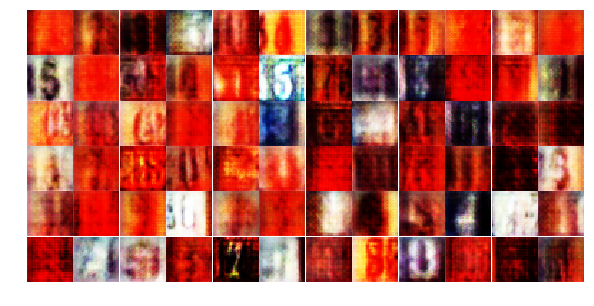

Epoch 16/20... Discriminator Loss: 0.2447... Generator Loss: 2.0421
Epoch 16/20... Discriminator Loss: 0.5890... Generator Loss: 1.1645
Epoch 16/20... Discriminator Loss: 0.4664... Generator Loss: 1.4020
Epoch 16/20... Discriminator Loss: 0.7104... Generator Loss: 0.9775
Epoch 16/20... Discriminator Loss: 0.0877... Generator Loss: 3.8537
Epoch 16/20... Discriminator Loss: 0.3176... Generator Loss: 1.8624
Epoch 16/20... Discriminator Loss: 0.3373... Generator Loss: 8.3388
Epoch 16/20... Discriminator Loss: 3.0026... Generator Loss: 0.1096
Epoch 16/20... Discriminator Loss: 0.2238... Generator Loss: 2.2942
Epoch 16/20... Discriminator Loss: 0.1591... Generator Loss: 2.5723


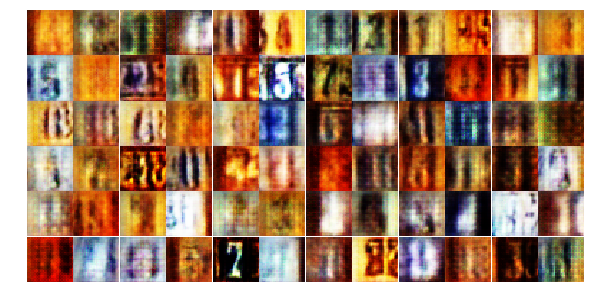

Epoch 16/20... Discriminator Loss: 0.1532... Generator Loss: 3.0325
Epoch 16/20... Discriminator Loss: 0.2988... Generator Loss: 2.5836
Epoch 16/20... Discriminator Loss: 0.2903... Generator Loss: 1.7393
Epoch 16/20... Discriminator Loss: 0.7632... Generator Loss: 4.8394
Epoch 16/20... Discriminator Loss: 0.1739... Generator Loss: 3.0327
Epoch 16/20... Discriminator Loss: 0.0722... Generator Loss: 3.4747
Epoch 16/20... Discriminator Loss: 0.4598... Generator Loss: 2.0300
Epoch 16/20... Discriminator Loss: 0.9950... Generator Loss: 0.6704
Epoch 16/20... Discriminator Loss: 0.2965... Generator Loss: 1.8212
Epoch 16/20... Discriminator Loss: 0.4240... Generator Loss: 1.7655


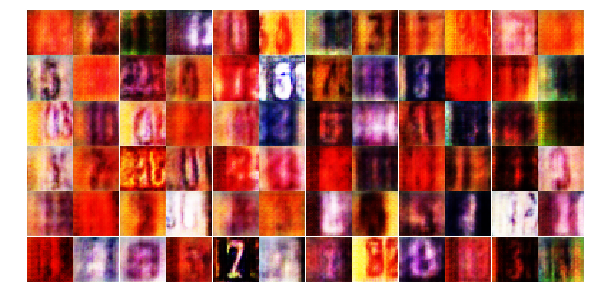

Epoch 16/20... Discriminator Loss: 2.0812... Generator Loss: 0.2165
Epoch 16/20... Discriminator Loss: 0.8256... Generator Loss: 0.9332
Epoch 16/20... Discriminator Loss: 0.0700... Generator Loss: 4.6578
Epoch 16/20... Discriminator Loss: 0.0414... Generator Loss: 4.4478
Epoch 16/20... Discriminator Loss: 0.0672... Generator Loss: 3.6123
Epoch 16/20... Discriminator Loss: 0.2718... Generator Loss: 2.4176
Epoch 17/20... Discriminator Loss: 0.3378... Generator Loss: 1.7880
Epoch 17/20... Discriminator Loss: 2.3518... Generator Loss: 0.2025
Epoch 17/20... Discriminator Loss: 0.8206... Generator Loss: 0.9875
Epoch 17/20... Discriminator Loss: 0.1656... Generator Loss: 6.5841


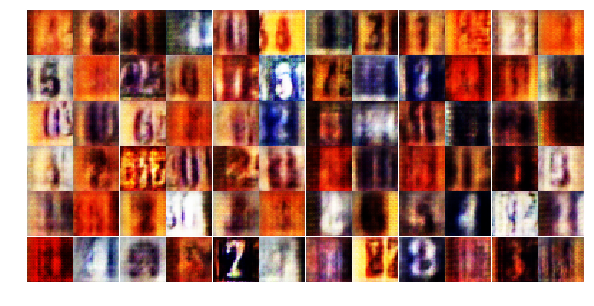

Epoch 17/20... Discriminator Loss: 0.4829... Generator Loss: 1.2840
Epoch 17/20... Discriminator Loss: 0.7176... Generator Loss: 1.0333
Epoch 17/20... Discriminator Loss: 0.3803... Generator Loss: 3.3440
Epoch 17/20... Discriminator Loss: 0.1153... Generator Loss: 2.8934
Epoch 17/20... Discriminator Loss: 0.5635... Generator Loss: 1.1772
Epoch 17/20... Discriminator Loss: 1.1368... Generator Loss: 0.5531
Epoch 17/20... Discriminator Loss: 0.2025... Generator Loss: 2.6025
Epoch 17/20... Discriminator Loss: 0.7778... Generator Loss: 0.8720
Epoch 17/20... Discriminator Loss: 0.2209... Generator Loss: 2.2792
Epoch 17/20... Discriminator Loss: 0.4105... Generator Loss: 4.9821


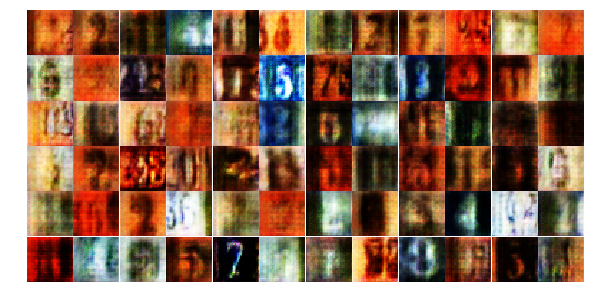

Epoch 17/20... Discriminator Loss: 0.7261... Generator Loss: 0.8667
Epoch 17/20... Discriminator Loss: 1.0178... Generator Loss: 0.7028
Epoch 17/20... Discriminator Loss: 0.3095... Generator Loss: 1.9208
Epoch 17/20... Discriminator Loss: 0.1619... Generator Loss: 2.7971
Epoch 17/20... Discriminator Loss: 0.7321... Generator Loss: 1.0525
Epoch 17/20... Discriminator Loss: 0.2967... Generator Loss: 1.7901
Epoch 17/20... Discriminator Loss: 0.1663... Generator Loss: 2.5370
Epoch 17/20... Discriminator Loss: 1.6603... Generator Loss: 0.3805
Epoch 17/20... Discriminator Loss: 0.2608... Generator Loss: 2.0826
Epoch 17/20... Discriminator Loss: 0.0841... Generator Loss: 3.8365


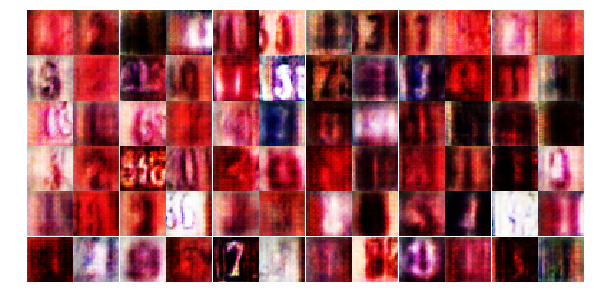

Epoch 17/20... Discriminator Loss: 0.4291... Generator Loss: 1.5579
Epoch 17/20... Discriminator Loss: 0.2445... Generator Loss: 2.1205
Epoch 17/20... Discriminator Loss: 0.7809... Generator Loss: 1.3711
Epoch 17/20... Discriminator Loss: 0.8864... Generator Loss: 0.8258
Epoch 17/20... Discriminator Loss: 0.2069... Generator Loss: 2.2550
Epoch 17/20... Discriminator Loss: 0.3565... Generator Loss: 1.7096
Epoch 17/20... Discriminator Loss: 0.1155... Generator Loss: 3.6587
Epoch 17/20... Discriminator Loss: 0.4772... Generator Loss: 1.8162
Epoch 17/20... Discriminator Loss: 1.2953... Generator Loss: 0.5565
Epoch 17/20... Discriminator Loss: 0.1501... Generator Loss: 3.0865


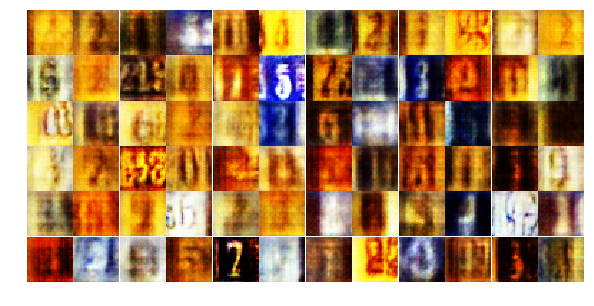

Epoch 17/20... Discriminator Loss: 0.1062... Generator Loss: 5.2722
Epoch 17/20... Discriminator Loss: 0.0941... Generator Loss: 3.2717
Epoch 17/20... Discriminator Loss: 0.6718... Generator Loss: 1.0040
Epoch 17/20... Discriminator Loss: 0.5162... Generator Loss: 1.4615
Epoch 17/20... Discriminator Loss: 0.0785... Generator Loss: 3.6399
Epoch 17/20... Discriminator Loss: 0.5111... Generator Loss: 1.4616
Epoch 17/20... Discriminator Loss: 0.0929... Generator Loss: 3.3828
Epoch 17/20... Discriminator Loss: 0.8318... Generator Loss: 0.8156
Epoch 17/20... Discriminator Loss: 0.6967... Generator Loss: 1.0862
Epoch 17/20... Discriminator Loss: 0.5944... Generator Loss: 1.1673


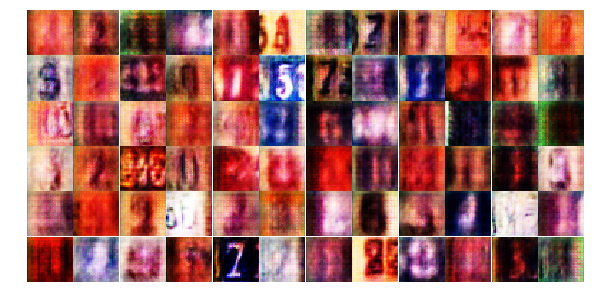

Epoch 17/20... Discriminator Loss: 0.4798... Generator Loss: 1.3678
Epoch 17/20... Discriminator Loss: 0.0655... Generator Loss: 3.6310
Epoch 17/20... Discriminator Loss: 0.0999... Generator Loss: 3.4464
Epoch 17/20... Discriminator Loss: 0.4505... Generator Loss: 1.3048
Epoch 17/20... Discriminator Loss: 0.9162... Generator Loss: 0.8331
Epoch 17/20... Discriminator Loss: 1.8784... Generator Loss: 0.2626
Epoch 17/20... Discriminator Loss: 3.0723... Generator Loss: 0.1372
Epoch 17/20... Discriminator Loss: 0.4385... Generator Loss: 1.6939
Epoch 17/20... Discriminator Loss: 0.3807... Generator Loss: 1.8913
Epoch 17/20... Discriminator Loss: 1.2626... Generator Loss: 0.5844


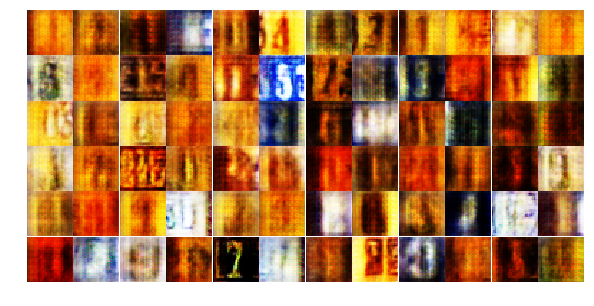

Epoch 17/20... Discriminator Loss: 1.9644... Generator Loss: 0.5023
Epoch 17/20... Discriminator Loss: 0.3005... Generator Loss: 2.0524
Epoch 17/20... Discriminator Loss: 0.1769... Generator Loss: 2.6367
Epoch 17/20... Discriminator Loss: 0.8631... Generator Loss: 0.8126
Epoch 18/20... Discriminator Loss: 0.1200... Generator Loss: 4.1408
Epoch 18/20... Discriminator Loss: 1.1075... Generator Loss: 0.7006
Epoch 18/20... Discriminator Loss: 0.5518... Generator Loss: 1.3235
Epoch 18/20... Discriminator Loss: 0.4164... Generator Loss: 1.5566
Epoch 18/20... Discriminator Loss: 0.6041... Generator Loss: 1.0987
Epoch 18/20... Discriminator Loss: 0.1377... Generator Loss: 2.4554


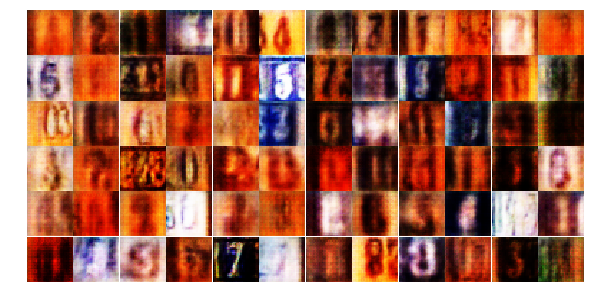

Epoch 18/20... Discriminator Loss: 0.0496... Generator Loss: 3.7651
Epoch 18/20... Discriminator Loss: 1.4855... Generator Loss: 0.3882
Epoch 18/20... Discriminator Loss: 0.1379... Generator Loss: 6.6983
Epoch 18/20... Discriminator Loss: 0.0502... Generator Loss: 3.9351
Epoch 18/20... Discriminator Loss: 0.1454... Generator Loss: 2.9529
Epoch 18/20... Discriminator Loss: 0.0190... Generator Loss: 5.8508
Epoch 18/20... Discriminator Loss: 0.6345... Generator Loss: 1.3469
Epoch 18/20... Discriminator Loss: 0.0879... Generator Loss: 5.2132
Epoch 18/20... Discriminator Loss: 0.7706... Generator Loss: 1.0567
Epoch 18/20... Discriminator Loss: 0.4006... Generator Loss: 1.5896


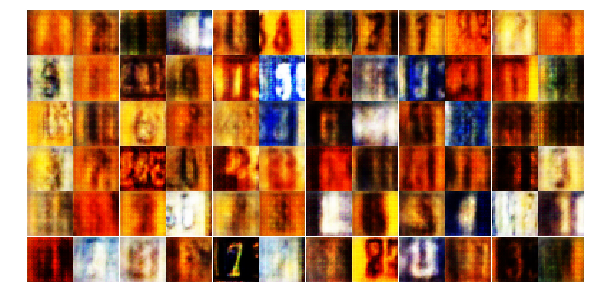

Epoch 18/20... Discriminator Loss: 0.0822... Generator Loss: 5.9094
Epoch 18/20... Discriminator Loss: 0.0698... Generator Loss: 4.0869
Epoch 18/20... Discriminator Loss: 0.3072... Generator Loss: 2.5104
Epoch 18/20... Discriminator Loss: 0.2994... Generator Loss: 3.2321
Epoch 18/20... Discriminator Loss: 0.2811... Generator Loss: 2.5628
Epoch 18/20... Discriminator Loss: 0.1736... Generator Loss: 6.6367
Epoch 18/20... Discriminator Loss: 0.9735... Generator Loss: 0.6536
Epoch 18/20... Discriminator Loss: 0.1888... Generator Loss: 2.4033
Epoch 18/20... Discriminator Loss: 0.4116... Generator Loss: 1.6046
Epoch 18/20... Discriminator Loss: 0.2851... Generator Loss: 2.1218


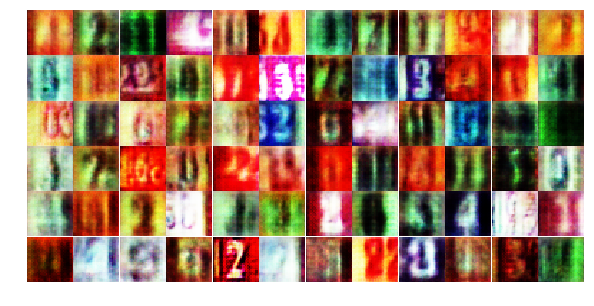

Epoch 18/20... Discriminator Loss: 0.2522... Generator Loss: 2.0492
Epoch 18/20... Discriminator Loss: 0.8001... Generator Loss: 0.8010
Epoch 18/20... Discriminator Loss: 0.7790... Generator Loss: 0.9247
Epoch 18/20... Discriminator Loss: 1.2081... Generator Loss: 0.5804
Epoch 18/20... Discriminator Loss: 0.0544... Generator Loss: 5.1591
Epoch 18/20... Discriminator Loss: 0.6104... Generator Loss: 1.0097
Epoch 18/20... Discriminator Loss: 0.3117... Generator Loss: 1.8537
Epoch 18/20... Discriminator Loss: 0.3811... Generator Loss: 1.5191
Epoch 18/20... Discriminator Loss: 0.2792... Generator Loss: 2.0338
Epoch 18/20... Discriminator Loss: 0.1447... Generator Loss: 3.7820


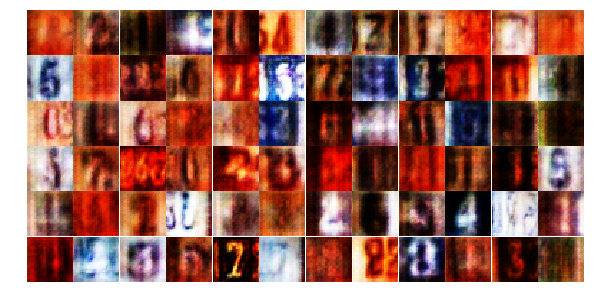

Epoch 18/20... Discriminator Loss: 0.1511... Generator Loss: 2.9911
Epoch 18/20... Discriminator Loss: 0.1843... Generator Loss: 3.1514
Epoch 18/20... Discriminator Loss: 0.1208... Generator Loss: 3.6007
Epoch 18/20... Discriminator Loss: 0.1580... Generator Loss: 5.4937
Epoch 18/20... Discriminator Loss: 0.6034... Generator Loss: 1.0880
Epoch 18/20... Discriminator Loss: 1.3359... Generator Loss: 0.5109
Epoch 18/20... Discriminator Loss: 2.5552... Generator Loss: 0.1724
Epoch 18/20... Discriminator Loss: 1.4310... Generator Loss: 0.4963
Epoch 18/20... Discriminator Loss: 0.1842... Generator Loss: 2.8017
Epoch 18/20... Discriminator Loss: 1.3799... Generator Loss: 0.4673


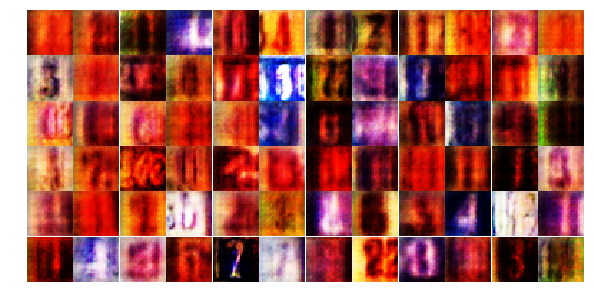

Epoch 18/20... Discriminator Loss: 0.9784... Generator Loss: 0.7162
Epoch 18/20... Discriminator Loss: 0.7217... Generator Loss: 1.1001
Epoch 18/20... Discriminator Loss: 1.1278... Generator Loss: 0.6099
Epoch 18/20... Discriminator Loss: 2.0638... Generator Loss: 0.2759
Epoch 18/20... Discriminator Loss: 0.0185... Generator Loss: 4.7539
Epoch 18/20... Discriminator Loss: 0.1624... Generator Loss: 3.0496
Epoch 18/20... Discriminator Loss: 0.7863... Generator Loss: 10.2668
Epoch 18/20... Discriminator Loss: 0.2661... Generator Loss: 2.1465
Epoch 18/20... Discriminator Loss: 0.7265... Generator Loss: 1.0236
Epoch 18/20... Discriminator Loss: 0.1113... Generator Loss: 3.7685


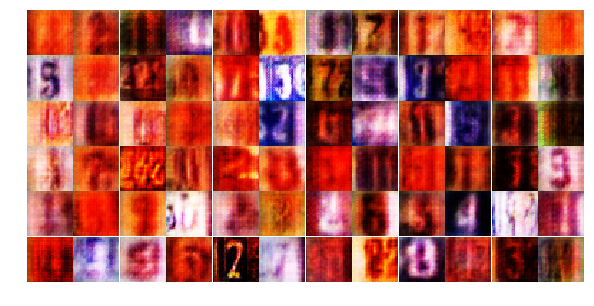

Epoch 18/20... Discriminator Loss: 0.5554... Generator Loss: 1.4556
Epoch 19/20... Discriminator Loss: 0.8775... Generator Loss: 0.8373
Epoch 19/20... Discriminator Loss: 0.3157... Generator Loss: 1.8410
Epoch 19/20... Discriminator Loss: 0.2471... Generator Loss: 2.0541
Epoch 19/20... Discriminator Loss: 1.4488... Generator Loss: 0.4999
Epoch 19/20... Discriminator Loss: 0.3127... Generator Loss: 1.9462
Epoch 19/20... Discriminator Loss: 0.0337... Generator Loss: 4.6734
Epoch 19/20... Discriminator Loss: 0.8355... Generator Loss: 0.7706
Epoch 19/20... Discriminator Loss: 0.6615... Generator Loss: 1.1019
Epoch 19/20... Discriminator Loss: 0.0655... Generator Loss: 3.9388


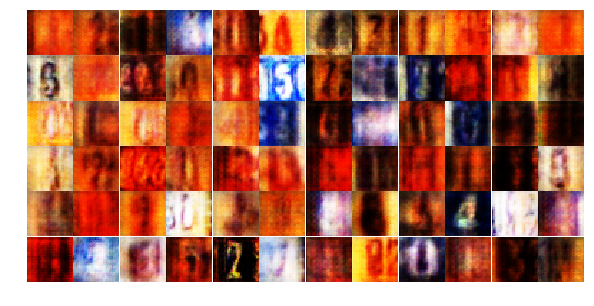

Epoch 19/20... Discriminator Loss: 0.0138... Generator Loss: 6.0469
Epoch 19/20... Discriminator Loss: 0.2901... Generator Loss: 1.9862
Epoch 19/20... Discriminator Loss: 0.3555... Generator Loss: 1.6865
Epoch 19/20... Discriminator Loss: 1.1219... Generator Loss: 0.5795
Epoch 19/20... Discriminator Loss: 0.1522... Generator Loss: 2.7240
Epoch 19/20... Discriminator Loss: 0.1535... Generator Loss: 2.7536
Epoch 19/20... Discriminator Loss: 0.1761... Generator Loss: 2.4828
Epoch 19/20... Discriminator Loss: 0.3694... Generator Loss: 1.5047
Epoch 19/20... Discriminator Loss: 0.5926... Generator Loss: 1.2485
Epoch 19/20... Discriminator Loss: 0.2056... Generator Loss: 2.4993


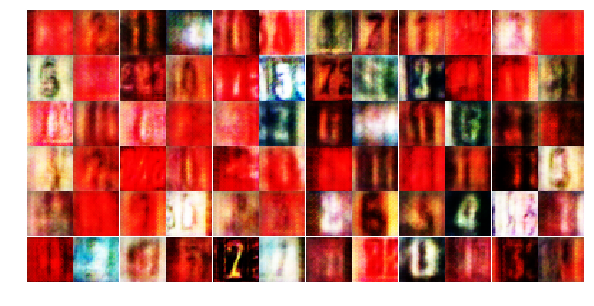

Epoch 19/20... Discriminator Loss: 0.2441... Generator Loss: 2.6074
Epoch 19/20... Discriminator Loss: 0.4140... Generator Loss: 1.6712
Epoch 19/20... Discriminator Loss: 0.0259... Generator Loss: 4.6150
Epoch 19/20... Discriminator Loss: 0.0416... Generator Loss: 5.0937
Epoch 19/20... Discriminator Loss: 0.6095... Generator Loss: 1.2164
Epoch 19/20... Discriminator Loss: 0.0485... Generator Loss: 4.2877
Epoch 19/20... Discriminator Loss: 0.3885... Generator Loss: 1.6065
Epoch 19/20... Discriminator Loss: 0.1546... Generator Loss: 2.5342
Epoch 19/20... Discriminator Loss: 0.6042... Generator Loss: 1.3112
Epoch 19/20... Discriminator Loss: 0.6015... Generator Loss: 1.1851


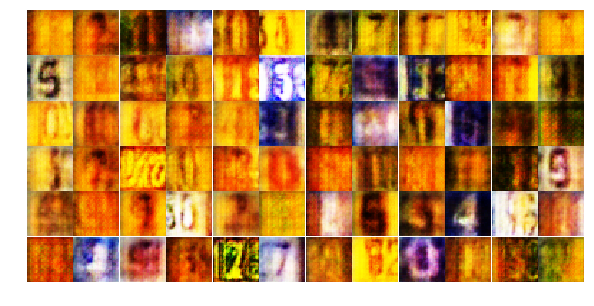

Epoch 19/20... Discriminator Loss: 1.2193... Generator Loss: 0.5359
Epoch 19/20... Discriminator Loss: 0.9542... Generator Loss: 0.8563
Epoch 19/20... Discriminator Loss: 0.2094... Generator Loss: 2.4053
Epoch 19/20... Discriminator Loss: 0.6652... Generator Loss: 1.1351
Epoch 19/20... Discriminator Loss: 1.4217... Generator Loss: 0.5004
Epoch 19/20... Discriminator Loss: 0.3608... Generator Loss: 1.6676
Epoch 19/20... Discriminator Loss: 1.5481... Generator Loss: 0.4379
Epoch 19/20... Discriminator Loss: 0.1603... Generator Loss: 3.3440
Epoch 19/20... Discriminator Loss: 2.1132... Generator Loss: 0.2910
Epoch 19/20... Discriminator Loss: 0.6665... Generator Loss: 8.2097


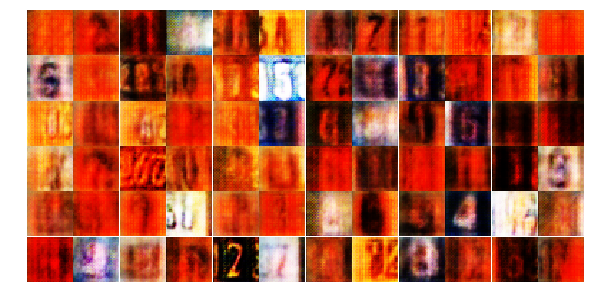

Epoch 19/20... Discriminator Loss: 0.0040... Generator Loss: 7.0334
Epoch 19/20... Discriminator Loss: 0.1098... Generator Loss: 3.4186
Epoch 19/20... Discriminator Loss: 0.1503... Generator Loss: 3.2543
Epoch 19/20... Discriminator Loss: 1.2791... Generator Loss: 0.8252
Epoch 19/20... Discriminator Loss: 2.0823... Generator Loss: 0.4632
Epoch 19/20... Discriminator Loss: 0.2389... Generator Loss: 2.3311
Epoch 19/20... Discriminator Loss: 0.8044... Generator Loss: 0.9140
Epoch 19/20... Discriminator Loss: 0.3416... Generator Loss: 2.0784
Epoch 19/20... Discriminator Loss: 0.6214... Generator Loss: 1.0466
Epoch 19/20... Discriminator Loss: 0.3935... Generator Loss: 1.5381


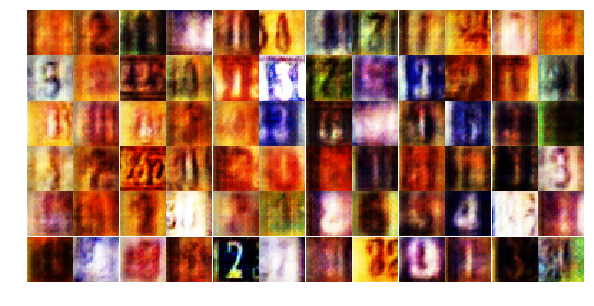

Epoch 19/20... Discriminator Loss: 0.8941... Generator Loss: 0.8183
Epoch 19/20... Discriminator Loss: 0.2273... Generator Loss: 2.3531
Epoch 19/20... Discriminator Loss: 1.8416... Generator Loss: 0.3554
Epoch 19/20... Discriminator Loss: 0.5158... Generator Loss: 1.4672
Epoch 19/20... Discriminator Loss: 0.1913... Generator Loss: 2.8538
Epoch 19/20... Discriminator Loss: 0.9219... Generator Loss: 0.7498
Epoch 19/20... Discriminator Loss: 0.1112... Generator Loss: 4.0462
Epoch 19/20... Discriminator Loss: 1.0633... Generator Loss: 0.6854
Epoch 20/20... Discriminator Loss: 0.1606... Generator Loss: 3.2211
Epoch 20/20... Discriminator Loss: 0.5155... Generator Loss: 1.2709


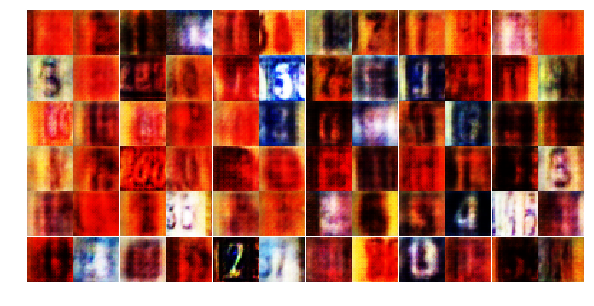

Epoch 20/20... Discriminator Loss: 0.2047... Generator Loss: 2.4975
Epoch 20/20... Discriminator Loss: 0.5311... Generator Loss: 1.4159
Epoch 20/20... Discriminator Loss: 0.7732... Generator Loss: 1.0031
Epoch 20/20... Discriminator Loss: 0.6201... Generator Loss: 1.1422
Epoch 20/20... Discriminator Loss: 0.5173... Generator Loss: 7.7989
Epoch 20/20... Discriminator Loss: 0.0468... Generator Loss: 4.2445
Epoch 20/20... Discriminator Loss: 0.9448... Generator Loss: 0.7775
Epoch 20/20... Discriminator Loss: 1.6864... Generator Loss: 0.4177
Epoch 20/20... Discriminator Loss: 0.1299... Generator Loss: 3.2757
Epoch 20/20... Discriminator Loss: 2.3573... Generator Loss: 0.1642


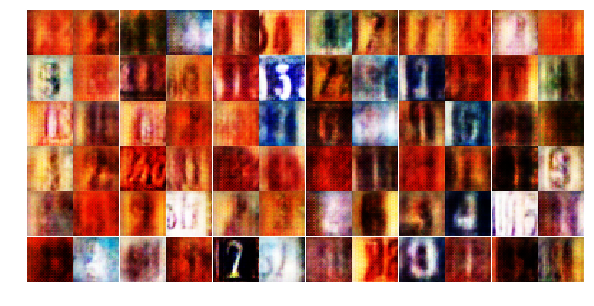

Epoch 20/20... Discriminator Loss: 0.3959... Generator Loss: 1.7985
Epoch 20/20... Discriminator Loss: 0.6381... Generator Loss: 1.1117
Epoch 20/20... Discriminator Loss: 0.0836... Generator Loss: 3.7355
Epoch 20/20... Discriminator Loss: 0.2571... Generator Loss: 2.1187
Epoch 20/20... Discriminator Loss: 0.5511... Generator Loss: 1.1141
Epoch 20/20... Discriminator Loss: 2.0038... Generator Loss: 0.2957
Epoch 20/20... Discriminator Loss: 0.3664... Generator Loss: 1.7966
Epoch 20/20... Discriminator Loss: 0.6474... Generator Loss: 1.1423
Epoch 20/20... Discriminator Loss: 0.8911... Generator Loss: 0.9159
Epoch 20/20... Discriminator Loss: 0.5035... Generator Loss: 1.3619


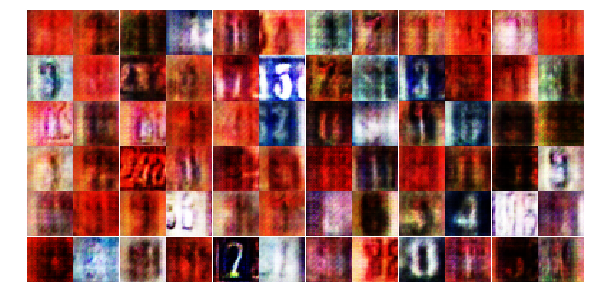

Epoch 20/20... Discriminator Loss: 0.1635... Generator Loss: 3.2108
Epoch 20/20... Discriminator Loss: 0.8573... Generator Loss: 0.9486
Epoch 20/20... Discriminator Loss: 0.5710... Generator Loss: 1.2813
Epoch 20/20... Discriminator Loss: 0.3398... Generator Loss: 1.6908
Epoch 20/20... Discriminator Loss: 0.4391... Generator Loss: 1.6634
Epoch 20/20... Discriminator Loss: 1.3083... Generator Loss: 0.5255
Epoch 20/20... Discriminator Loss: 0.5965... Generator Loss: 1.1636
Epoch 20/20... Discriminator Loss: 0.1449... Generator Loss: 2.7828
Epoch 20/20... Discriminator Loss: 0.4764... Generator Loss: 1.5080
Epoch 20/20... Discriminator Loss: 0.6667... Generator Loss: 1.0891


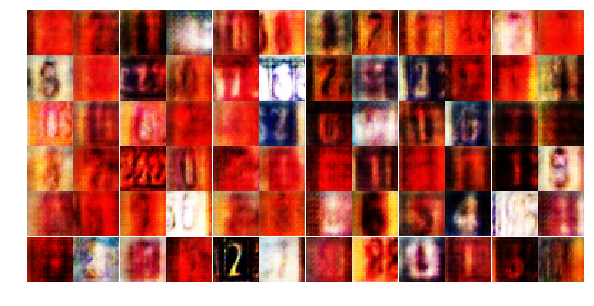

Epoch 20/20... Discriminator Loss: 1.0905... Generator Loss: 0.5551
Epoch 20/20... Discriminator Loss: 0.2766... Generator Loss: 1.9986
Epoch 20/20... Discriminator Loss: 0.1789... Generator Loss: 2.5189
Epoch 20/20... Discriminator Loss: 0.5664... Generator Loss: 1.3976
Epoch 20/20... Discriminator Loss: 0.4855... Generator Loss: 1.2970
Epoch 20/20... Discriminator Loss: 0.1748... Generator Loss: 2.2840
Epoch 20/20... Discriminator Loss: 0.1047... Generator Loss: 3.2599
Epoch 20/20... Discriminator Loss: 1.0019... Generator Loss: 0.7751
Epoch 20/20... Discriminator Loss: 0.9717... Generator Loss: 0.7391
Epoch 20/20... Discriminator Loss: 0.6163... Generator Loss: 1.0368


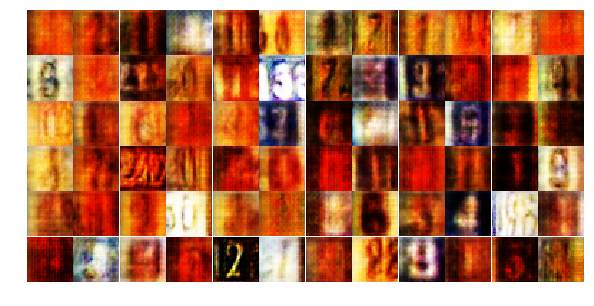

Epoch 20/20... Discriminator Loss: 0.4993... Generator Loss: 1.3265
Epoch 20/20... Discriminator Loss: 0.0703... Generator Loss: 4.4661
Epoch 20/20... Discriminator Loss: 0.1460... Generator Loss: 4.6472
Epoch 20/20... Discriminator Loss: 1.3401... Generator Loss: 0.5454
Epoch 20/20... Discriminator Loss: 1.6187... Generator Loss: 0.3859
Epoch 20/20... Discriminator Loss: 0.9585... Generator Loss: 0.7648
Epoch 20/20... Discriminator Loss: 0.2121... Generator Loss: 2.2813
Epoch 20/20... Discriminator Loss: 0.9542... Generator Loss: 0.7354
Epoch 20/20... Discriminator Loss: 0.0708... Generator Loss: 3.5146
Epoch 20/20... Discriminator Loss: 1.5888... Generator Loss: 0.4281


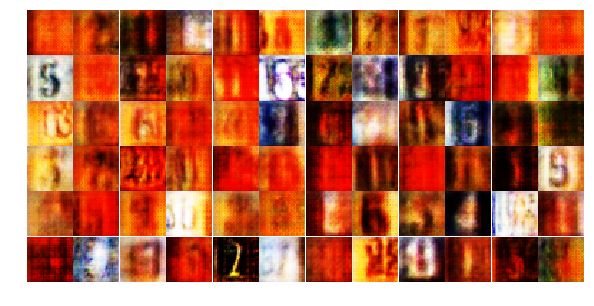

Epoch 20/20... Discriminator Loss: 0.5970... Generator Loss: 1.1497
Epoch 20/20... Discriminator Loss: 0.1852... Generator Loss: 2.5075
Epoch 20/20... Discriminator Loss: 1.1906... Generator Loss: 0.6632
Epoch 20/20... Discriminator Loss: 0.4386... Generator Loss: 4.4740
Epoch 20/20... Discriminator Loss: 0.0594... Generator Loss: 5.2400
Epoch 20/20... Discriminator Loss: 1.5449... Generator Loss: 0.4065


In [22]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

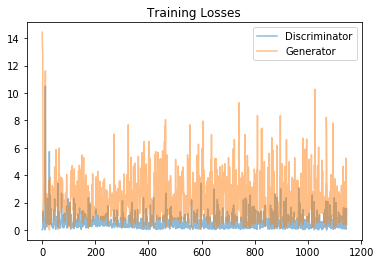

In [23]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

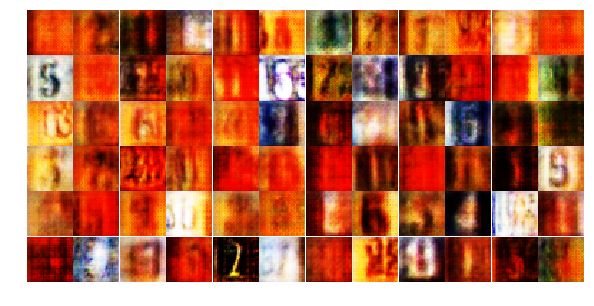

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))